<a href="https://colab.research.google.com/github/easy-min/IT_business/blob/main/ITB_Subject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 여가시간에 "운동 활동"을 하도록 만들자



## [1] 데이터 분석 배경 및 목적

### (1) 데이터 분석 배경

앞서서 체력증진에 운동이 매우 필요하다는 것을 입증했다. 따라서 시민들의 체력 증진을 위해 운동 활동을 권장하는 것이 필요하다. 이를 위해 여가시간에 적극적으로 걷기 활동을 하도록 유도하는 마케팅 방안이 필요하다. 
이 때 각 집단별 특성에 따라 그 마케팅 방법을 다르게 할 필요가 있다. 따라서 집단에 따라 그 특징을 분석하고 해당 특성에 맞게 마케팅 방안을 도출하고자 한다. **(앞에 한 팀에 따라 수정)**

### (2) 데이터 분석 목적
- 현재 시민들이 여가시간에 주로 어느 활동을 하는지 분석한다.
 - 시민들을 특징에 따라 여러 집단으로 나눈다.
 - 집단별로 어느 특징이 두드러지는지 시각화를 통해 확인한다.
- 설문조사에서 빠진 일부 항목을 모델링 과정을 통해 채워 넣는다.
 - "여가"와 관련된 설문 조사 중 "현재 여가에 어느 정도 지출하고 있는가"와 "미래 여가에 대한 지출을 얼마나 늘릴 것인가"에 대한 질문이 빠져 있다. 
 - 해당 질문은 여가에 대한 관심을 보여주는 효과적인 지표 중 하나이기 때문에 이를 유추할 필요가 있다.
  - 따라서 모든 데이터가 존재하는 데이터를 이용해 모델을 세우고, 해당 모델로 질문에 대한 답을 채워넣고자 한다.

### (3) 사용하고자 하는 데이터 목록

데이터 분석을 위해, "문화 빅데이터" 사이트의 데이터를 이용하고자 했다. 다음 데이터들은 ㈜컨슈머인사이트 정기 기획조사를 통한 설문조사 결과로, 2021년 11월 이후부터 매주 수집된 온라인(PC/모바일) 소비자 서베이 데이터이다. 

(1) 여가 관련 지출 동향 및 의향
- 여가시간을 보내기 위해 지출한 비용이 작년 대비 어느정도인지, 앞으로 어떻게 변할 것으로 예상하는지에 대한 소비자 응답값 (5점 척도)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

(2) 하루 평균 여가문화 시간 및 사용 비중
- 지난 일주일간의 하루 평균 여가 시간을 평일/주말 각각 어떤 목적으로 활용(휴식/오락, 취미, 대인관계/교제, 등)했는지에 대한 소비자 응답값 (비중, %)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

(3) 여가/문화 유형별 관심도
- 작년 동시기 대비 여가/문화 8개 유형(문화예술 관람하기, 운동/스포츠 직접하기, 관광/여행, 자기계발/자기관리 등)에 대한 관심 변화 정도 응답값 (5점 척도)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

해당 데이터들에서 공통적으로 "응답자 ID", "조사기간", "성별", "연령대", "거주지역", "소득수준"이 포함되어 있다는 것을 확인하고, 해당 설문조사가 동시에 이뤄진 것인지 추후 확인하고자 한다.

## [2] 데이터 전처리

(1) df_leisure = 여가 관련 지출 동향 및 의향

(2) df_use = 하루 평균 여가문화 시간 및 사용 비중

(3) df_interest = 여가/문화 유형별 관심도

In [ ]:
from google.colab import drive #colab과 google drive 연결
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import os # 데이터를 불러오고, CSV 파일을 하나로 합치는데 필요한 패키지들
import pandas as pd
import glob

### (1) 여가 관련 지출 동향 및 의향
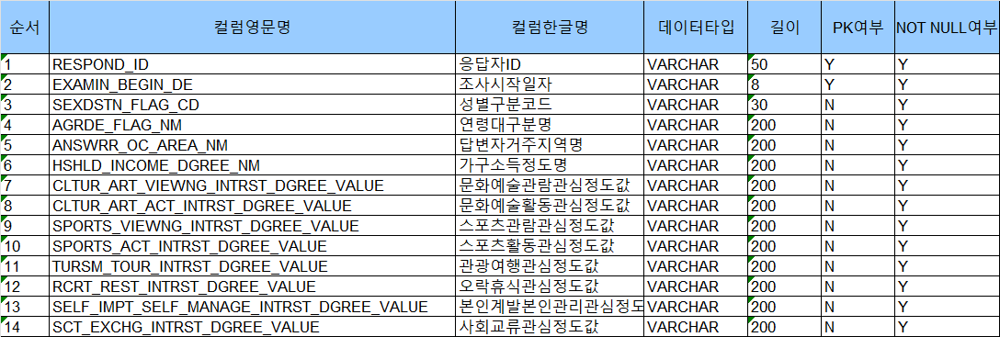

In [ ]:
files = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/leisure_raw", "*.csv")
files = glob.glob(files)
# joining files with concat and read_csv
df_leisure = pd.concat(map(pd.read_csv, files), ignore_index=True)
print(df_leisure)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322319         20220824               F           50대   
1        53322352         20220824               F           50대   
2        53322506         20220824               M           20대   
3        53322878         20220824               F           60대   
4        53322944         20220824               F           60대   
...           ...              ...             ...           ...   
31407    53376635         20220314               F           60대   
31408    53376793         20220314               F           60대   
31409    53376867         20220314               F           50대   
31410    53376992         20220314               F           40대   
31411    53377235         20220314               M           20대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM LSR_CT_EXPNDTR_TNDCY_VALUE  \
0                 서울특별시         500이상700만원 미만                       비슷하다   
1                 서울특별시        

In [ ]:
df_leisure_new = df_leisure.copy() # 변수명 간단하게 변경
df_leisure_new = df_leisure_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_leisure_new = df_leisure_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'})  # 성별
df_leisure_new = df_leisure_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_leisure_new = df_leisure_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_leisure_new = df_leisure_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)
df_leisure_new = df_leisure_new.rename (columns = {'LSR_CT_EXPNDTR_TNDCY_VALUE': 'TENDENCY'}) # 레저비용지출동향값
df_leisure_new = df_leisure_new.rename (columns = {'LSR_CT_EXPNDTR_INTEN_VALUE': 'WANT'}) # 레저비용지출의향값

In [ ]:
display(df_leisure_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT
0,53322319,20220824,F,50대,서울특별시,500이상700만원 미만,비슷하다,비슷할 것이다
1,53322352,20220824,F,50대,서울특별시,500이상700만원 미만,증가한 편이다,비슷할 것이다
2,53322506,20220824,M,20대,서울특별시,300만원 미만,증가한 편이다,감소할 것이다
3,53322878,20220824,F,60대,서울특별시,300만원 미만,비슷하다,감소할 것이다
4,53322944,20220824,F,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다
...,...,...,...,...,...,...,...,...
31407,53376635,20220314,F,60대,서울특별시,300만원 미만,비슷하다,비슷할 것이다
31408,53376793,20220314,F,60대,서울특별시,300이상500만원 미만,감소한 편이다,증가할 것이다
31409,53376867,20220314,F,50대,세종특별자치시,500이상700만원 미만,증가한 편이다,비슷할 것이다
31410,53376992,20220314,F,40대,경상북도,300만원 미만,증가한 편이다,증가할 것이다


In [ ]:
df_leisure_new[df_leisure_new.RESPOND_ID == 53322261]  #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT
1583,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다
22330,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다
24378,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다


### (2) 하루 평균 여가문화 시간 및 사용 비중
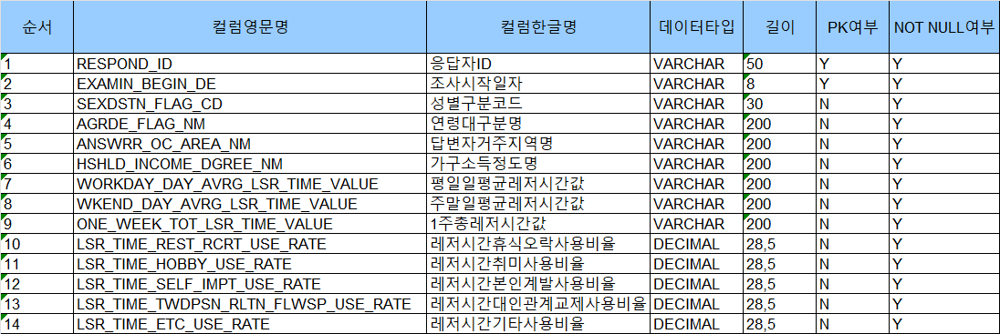

In [ ]:
files2 = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/use_raw", "*.csv")
files2 = glob.glob(files2)
# joining files with concat and read_csv
df_use = pd.concat(map(pd.read_csv, files2), ignore_index=True)
print(df_use)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322394         20220810               F           50대   
1        53322420         20220810               F           50대   
2        53322575         20220810               F           20대   
3        53322714         20220810               M           20대   
4        53322837         20220810               M           40대   
...           ...              ...             ...           ...   
38623    53377219         20220713               F           50대   
38624    53377301         20220713               M           30대   
38625    53377343         20220713               M           30대   
38626    53377392         20220713               M           50대   
38627    53377429         20220713               M           60대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM  \
0                 서울특별시              700만원 이상   
1                 서울특별시         300이상500만원 미만   
2                 서울특별시             

In [ ]:
df_use_new = df_use.copy() # 변수명 간단하게 변경
df_use_new = df_use_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_use_new = df_use_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'}) # 성별
df_use_new = df_use_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_use_new = df_use_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_use_new = df_use_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)
df_use_new = df_use_new.rename (columns = {'LSR_CT_EXPNDTR_TNDCY_VALUE': 'TENDENCY'}) # 레저비용지출동향값
df_use_new = df_use_new.rename (columns = {'LSR_CT_EXPNDTR_INTEN_VALUE': 'WANT'}) # 레저비용지출의향값

df_use_new = df_use_new.rename (columns = {'WORKDAY_DAY_AVRG_LSR_TIME_VALUE': 'WORKDAY'}) # 평일일평균레저시간값
df_use_new = df_use_new.rename (columns = {'WKEND_DAY_AVRG_LSR_TIME_VALUE': 'WKEND'}) # 주말일평균레저시간값
df_use_new = df_use_new.rename (columns = {'ONE_WEEK_TOT_LSR_TIME_VALUE': 'ONEWEEK'}) # 1주총레저시간값
df_use_new = df_use_new.rename (columns = {'LSR_TIME_REST_RCRT_USE_RATE': 'REST'}) # 레저시간휴식오락사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_HOBBY_USE_RATE': 'HOBBY'}) # 레저시간취미사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_SELF_IMPT_USE_RATE': 'SELF'}) # 레저시간본인계발사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_TWDPSN_RLTN_FLWSP_USE_RATE': 'SOCIAL'}) # 레저시간대인관계교제사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_ETC_USE_RATE': 'ETC'}) # 레저시간기타사용비율

In [ ]:
display(df_use_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC
0,53322394,20220810,F,50대,서울특별시,700만원 이상,3,8,31,10,40,10,40,0
1,53322420,20220810,F,50대,서울특별시,300이상500만원 미만,4,6,32,50,5,30,15,0
2,53322575,20220810,F,20대,서울특별시,300만원 미만,5,12,49,30,10,20,40,0
3,53322714,20220810,M,20대,서울특별시,300이상500만원 미만,2,4,18,0,5,10,85,0
4,53322837,20220810,M,40대,서울특별시,300이상500만원 미만,5,5,35,70,0,0,30,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,53377219,20220713,F,50대,인천광역시,700만원 이상,1,5,15,35,25,25,15,0
38624,53377301,20220713,M,30대,서울특별시,500이상700만원 미만,2,4,18,59,22,12,7,0
38625,53377343,20220713,M,30대,경상남도,300만원 미만,1,3,11,60,20,20,0,0
38626,53377392,20220713,M,50대,전라북도,500이상700만원 미만,2,4,18,30,50,10,10,0


In [ ]:
df_use_new[df_use_new.RESPOND_ID == 53322261] #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC
3692,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,3,8,31,10,50,10,5,25
14634,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,2,8,26,50,30,0,20,0
18687,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,2,8,26,50,30,0,20,0


### (3) 여가/문화 유형별 관심도
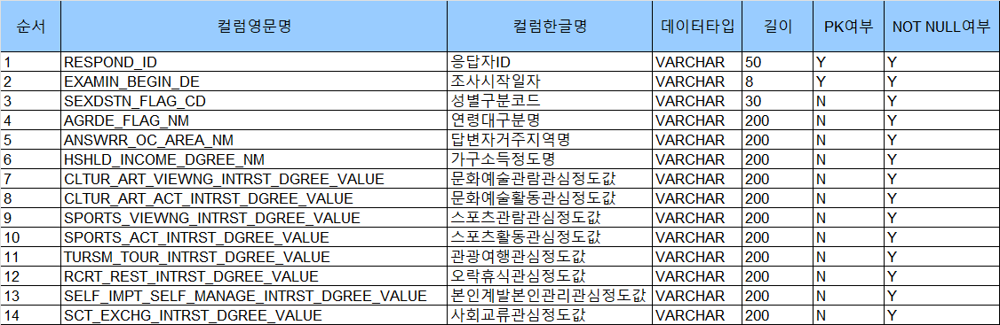

In [ ]:
files4 = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/interest_raw", "*.csv")
files4 = glob.glob(files4)
# joining files with concat and read_csv
df_interest = pd.concat(map(pd.read_csv, files4), ignore_index=True)
print(df_interest)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322319         20220824               F           50대   
1        53322352         20220824               F           50대   
2        53322506         20220824               M           20대   
3        53322878         20220824               F           60대   
4        53322944         20220824               F           60대   
...           ...              ...             ...           ...   
31407     3217343         20220202               F           40대   
31408     3222218         20220202               M           20대   
31409     3222891         20220202               M           60대   
31410     3226201         20220202               M           20대   
31411     3241763         20220202               M           50대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM  \
0                 서울특별시         500이상700만원 미만   
1                 서울특별시         500이상700만원 미만   
2                 서울특별시             

In [ ]:
df_interest_new = df_interest.copy() # 변수명 간단하게 변경
df_interest_new = df_interest_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_interest_new = df_interest_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'}) # 성별
df_interest_new = df_interest_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_interest_new = df_interest_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_interest_new = df_interest_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)

df_interest_new = df_interest_new.rename (columns = {'CLTUR_ART_VIEWNG_INTRST_DGREE_VALUE': 'INTER_CUL_VIEW'}) # 문화예술관람관심정도값
df_interest_new = df_interest_new.rename (columns = {'CLTUR_ART_ACT_INTRST_DGREE_VALUE': 'INTER_CUL_ACT'}) # 문화예술활동관심정도값
df_interest_new = df_interest_new.rename (columns = {'SPORTS_VIEWNG_INTRST_DGREE_VALUE': 'INTER_SPORT_VIEW'}) # 스포츠관람관심정도값
df_interest_new = df_interest_new.rename (columns = {'SPORTS_ACT_INTRST_DGREE_VALUE': 'INTER_SPORT_ACT'}) # 스포츠활동관심정도값
df_interest_new = df_interest_new.rename (columns = {'TURSM_TOUR_INTRST_DGREE_VALUE': 'INTER_TRAVEL'}) # 관광여행관심정도값
df_interest_new = df_interest_new.rename (columns = {'RCRT_REST_INTRST_DGREE_VALUE': 'INTER_REST'}) # 오락휴식관심정도값
df_interest_new = df_interest_new.rename (columns = {'SELF_IMPT_SELF_MANAGE_INTRST_DGREE_VALUE': 'INTER_SELF'}) # 본인계발본인관리관심정도값
df_interest_new = df_interest_new.rename (columns = {'SCT_EXCHG_INTRST_DGREE_VALUE': 'INTER_SOCIAL'}) # 사회교류관심정도값

In [ ]:
display(df_interest_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322319,20220824,F,50대,서울특별시,500이상700만원 미만,조금 커졌다,조금 커졌다,비슷하다,비슷하다,매우 커졌다,비슷하다,조금 커졌다,비슷하다
1,53322352,20220824,F,50대,서울특별시,500이상700만원 미만,조금 작아졌다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,조금 커졌다,비슷하다
2,53322506,20220824,M,20대,서울특별시,300만원 미만,비슷하다,조금 작아졌다,매우 작아졌다,비슷하다,비슷하다,조금 커졌다,비슷하다,조금 작아졌다
3,53322878,20220824,F,60대,서울특별시,300만원 미만,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다
4,53322944,20220824,F,60대,서울특별시,300이상500만원 미만,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,조금 커졌다
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31407,3217343,20220202,F,40대,서울특별시,300만원 미만,조금 커졌다,매우 커졌다,조금 커졌다,비슷하다,조금 커졌다,비슷하다,비슷하다,조금 작아졌다
31408,3222218,20220202,M,20대,서울특별시,300이상500만원 미만,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다
31409,3222891,20220202,M,60대,부산광역시,500이상700만원 미만,조금 커졌다,비슷하다,조금 커졌다,조금 커졌다,조금 작아졌다,조금 커졌다,조금 작아졌다,조금 작아졌다
31410,3226201,20220202,M,20대,경기도,300만원 미만,조금 작아졌다,매우 작아졌다,매우 작아졌다,비슷하다,매우 작아졌다,조금 커졌다,매우 작아졌다,매우 작아졌다


In [ ]:
df_interest_new[df_interest_new.RESPOND_ID == 53322261] #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
1588,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,비슷하다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,비슷하다,조금 작아졌다
17155,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다
18688,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다


### (4) 데이터 병합

위의 데이터들은 전부 "한 조사 기관"에서 나온 설문조사 결과이고 이 모든 설문조사에 응답한 객체가 존재하므로 이 프레임을 합칠 수 있다. pandas의 merge on(조건) how = 조인 방법 이용해서 데이터 프레임 합치고자 한다.

In [ ]:
import pandas as pd #outer join을 이용해 모든 데이터가 입력 (입력 값 없는 경우 NAN 지동 지정)
df1 = pd.merge(df_leisure_new, df_use_new, on = ['DATE', 'RESPOND_ID', 'SEX', 'AGE', 'DO', 'MONEY'], how = 'outer')
df1 = pd.merge(df1, df_interest_new, on = ['DATE', 'RESPOND_ID', 'SEX', 'AGE', 'DO', 'MONEY'], how = 'outer')
display(df1)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322319,20220824,F,50대,서울특별시,500이상700만원 미만,비슷하다,비슷할 것이다,4,6,...,20,0,조금 커졌다,조금 커졌다,비슷하다,비슷하다,매우 커졌다,비슷하다,조금 커졌다,비슷하다
1,53322352,20220824,F,50대,서울특별시,500이상700만원 미만,증가한 편이다,비슷할 것이다,2,2,...,20,0,조금 작아졌다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,조금 커졌다,비슷하다
2,53322506,20220824,M,20대,서울특별시,300만원 미만,증가한 편이다,감소할 것이다,3,7,...,30,0,비슷하다,조금 작아졌다,매우 작아졌다,비슷하다,비슷하다,조금 커졌다,비슷하다,조금 작아졌다
3,53322878,20220824,F,60대,서울특별시,300만원 미만,비슷하다,감소할 것이다,3,5,...,30,0,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다,매우 작아졌다
4,53322944,20220824,F,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다,1,2,...,30,0,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,조금 커졌다
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3230048,20211222,M,20대,서울특별시,300이상500만원 미만,NaN,NaN,2,4,...,25,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3238610,20211222,F,20대,울산광역시,300만원 미만,NaN,NaN,5,10,...,20,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3239449,20211222,M,30대,강원도,300만원 미만,NaN,NaN,2,5,...,50,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3242506,20211222,M,50대,경기도,700만원 이상,NaN,NaN,4,6,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df1[df1.RESPOND_ID == 53322261] # 앞서서 확인했던 모두 응답한 ID의 설문조사 내용이 전부 JOIN 된 것을 확인

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
1583,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다,3,8,...,5,25,비슷하다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,비슷하다,조금 작아졌다
22330,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다,2,8,...,20,0,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다
24378,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다,2,8,...,20,0,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다


### (5) 데이터 척도값 변경
효율적으로 처리하기 위해 한글로 쓰여진 척도값을 숫자로 변경

이 때 원본은 변경되지 않도록 df2를 새로 만들어 저장

In [ ]:
df2 = df1.copy()
df2 = df2.replace({'매우 작아졌다':1, '조금 작아졌다':2, '비슷하다':3, '조금 커졌다':4, '매우 커졌다':5})
df2 = df2.replace({'크게 감소했다':1, '감소한 편이다':2, '비슷하다':3, '증가한 편이다':4, '크게 증가했다':5})
df2 = df2.replace({'크게 감소할 것이다':1, '감소할 것이다':2, '비슷할 것이다':3, '증가할 것이다':4, '크게 증가할 것이다':5})
df2 = df2.replace({'300만원 미만':1, '300이상500만원 미만':2, '500이상700만원 미만':3, '700만원 이상':4})
# df2 = df2.replace({'M':0, 'F':1})  # 지금 당장은 변경할 필요 없음
# df2 = df2.replace({'20대':2, '30대':3, '40대':4, '50대':5,'60대':6}) # 지금 당장은 변경할 필요 없음

In [ ]:
display(df2)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322319,20220824,F,50대,서울특별시,3,3.0,3.0,4,6,...,20,0,4.0,4.0,3.0,3.0,5.0,3.0,4.0,3.0
1,53322352,20220824,F,50대,서울특별시,3,4.0,3.0,2,2,...,20,0,2.0,3.0,3.0,4.0,3.0,3.0,4.0,3.0
2,53322506,20220824,M,20대,서울특별시,1,4.0,2.0,3,7,...,30,0,3.0,2.0,1.0,3.0,3.0,4.0,3.0,2.0
3,53322878,20220824,F,60대,서울특별시,1,3.0,2.0,3,5,...,30,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,53322944,20220824,F,60대,서울특별시,2,3.0,4.0,1,2,...,30,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3230048,20211222,M,20대,서울특별시,2,NaN,NaN,2,4,...,25,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3238610,20211222,F,20대,울산광역시,1,NaN,NaN,5,10,...,20,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3239449,20211222,M,30대,강원도,1,NaN,NaN,2,5,...,50,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3242506,20211222,M,50대,경기도,4,NaN,NaN,4,6,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### (6)  데이터 확인

In [ ]:
df2.info() # 전체 데이터 38628개

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38628 entries, 0 to 38627
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   RESPOND_ID        38628 non-null  int64  
 1   DATE              38628 non-null  int64  
 2   SEX               38628 non-null  object 
 3   AGE               38628 non-null  object 
 4   DO                38628 non-null  object 
 5   MONEY             38628 non-null  object 
 6   TENDENCY          31412 non-null  float64
 7   WANT              31412 non-null  float64
 8   WORKDAY           38628 non-null  int64  
 9   WKEND             38628 non-null  int64  
 10  ONEWEEK           38628 non-null  int64  
 11  REST              38628 non-null  int64  
 12  HOBBY             38628 non-null  int64  
 13  SELF              38628 non-null  int64  
 14  SOCIAL            38628 non-null  int64  
 15  ETC               38628 non-null  int64  
 16  INTER_CUL_VIEW    31412 non-null  float6

In [ ]:
df2['RESPOND_ID'] = df2['RESPOND_ID'].astype(str) # RESPOND_ID 는 숫자로 계산할 필요가 없는 KEY이므로 문자로 변환

In [ ]:
display(df2.isna().sum()) # 결측치 수 : 일부에서 7216개 (3개의 설문조사를 합치는 과정에서 모든 설문에 응답하지 않은 객체의 NA값 발생)
 # 변수 "TENDENCY", "WANT", "INTER"와 관련된 데이터 중 7216개가 NA값임.

RESPOND_ID             0
DATE                   0
SEX                    0
AGE                    0
DO                     0
MONEY                  0
TENDENCY            7216
WANT                7216
WORKDAY                0
WKEND                  0
ONEWEEK                0
REST                   0
HOBBY                  0
SELF                   0
SOCIAL                 0
ETC                    0
INTER_CUL_VIEW      7216
INTER_CUL_ACT       7216
INTER_SPORT_VIEW    7216
INTER_SPORT_ACT     7216
INTER_TRAVEL        7216
INTER_REST          7216
INTER_SELF          7216
INTER_SOCIAL        7216
dtype: int64

In [ ]:
df2.describe()

,DATE,TENDENCY,WANT,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
count,3.862800e+04,31412.000000,31412.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000
mean,2.021925e+07,3.238444,3.383611,3.060474,5.865253,27.032878,41.945946,19.366884,13.278606,22.133841,3.274723,3.021934,2.890074,2.936298,3.210206,3.345664,3.406310,3.257768,2.959792
std,3.187322e+03,0.820258,0.735876,2.222386,3.481849,15.549568,25.728483,19.361442,15.426196,18.889275,11.992920,0.997081,0.975805,0.968603,0.971318,1.148029,0.864867,0.913534,0.977415
min,2.021110e+07,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,2.022021e+07,3.000000,3.000000,2.000000,3.000000,16.000000,20.000000,0.000000,0.000000,10.000000,0.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,3.000000,2.000000
50%,2.022042e+07,3.000000,3.000000,3.000000,5.000000,25.000000,40.000000,15.000000,10.000000,20.000000,0.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
75%,2.022063e+07,4.000000,4.000000,4.000000,8.000000,35.000000,60.000000,30.000000,20.000000,30.000000,0.000000,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
max,2.022093e+07,5.000000,5.000000,18.000000,18.000000,126.000000,100.000000,100.000000,100.000000,100.000000,100.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


## [3] 데이터 시각화

분석에 앞서서, 해당 원데이터에서 운동과 직접적으로 관련된 컬럼은 없다. 따라서 "여가시간에 운동을 유도하는데 가장 중요한 변수"를 임의로 설정하고자 한다. 
- 먼저 여가 사용 비중 변수들은(REST(휴식 및 오락), HOBBY(취미), TRAVEL(여행), SOCIAL(소셜 활동), ETC(기타)) 응답자가 운동을 어떻게 생각하느냐에 따라 운동을 REST(오락 활동으로 볼링을 치러간다.)나 HOBBY(수영을 취미로 배운다.) 또는 SOCIAL(친구들과 같이 골프를 치면서 관계를 쌓는다.) 등으로 선택할 수 있어 적절하지 않다.
- WORKDAY, WKEND, ONEWEEK 등 응답자가 얼마나 여가시간을 보내느냐는 단순 수치만 있다. 물론 절대적인 시간이 많아지면, 운동에 관한 여가 활동도 늘어날 수 밖에 없지만 해당 조사는 "휴식" 또한 여가활동으로 포함하고 있는데다가 그 "휴식"이 포함된 "REST"변수가 전체의 41%로 큰 비중을 차지하고 있어 적절하지 않다.
- 여가와 관련된 지출 변수 중  "TENDENCY(현재 여가에 얼마나 지출을 하고 있는지)", "WANT(미래에 여가와 관련해 지출을 어떻게 변경할 것인지)" 의 변수는 역시 여행과 문화 생활에 영향을 받아 완벽하지 않다. 그러나 해당 조사결과가 코로나 활동으로 인해 해외여행 및 문화 생활이 쉽지 않았던 2021년 11월 이후 부터의 데이터라는 점, 그리고 한국의 경우 상대적으로 운동을 하기 위해 헬스장에서 PT를 받거나 해당 운동에 필요한 물품을 사는데 돈을 기꺼이 지불하는 경우가 많다는 점, 마지막으로 코로나 기간에 골프나 테니스 등 소위 고급 스포츠들의 인기가 급상승했다는 점을 근거로 해당 변수를 집중적으로 분석하고자 한다.

In [ ]:
%matplotlib inline
import matplotlib as mpl               # 기본 설정
import matplotlib.pyplot as plt        # 그래프 관련
import matplotlib.font_manager as fm   # 폰트 관련

mpl.rcParams['axes.unicode_minus'] = False  ## 마이너스 부호가 깨지는 것 방지 

!apt-get update -qq
!apt-get install fonts-nanum* -qq              # 나눔 폰트 설치

sys_font=fm.findSystemFonts()
print(f"sys_font number: {len(sys_font)}")
print(sys_font)                                # 전체 폰트 개수

nanum_font = [f for f in sys_font if 'Nanum' in f]
print(f"nanum_font number: {len(nanum_font)}") # 나눔 폰트 개수 (설치된 것을 확인)
#nanum_font

# 설치된 나눔글꼴중 원하는 폰트의 전체 경로 가져오기 
path = '/usr/share/fonts/truetype/nanum/NanumGothicEco.ttf'  
font_name = fm.FontProperties(fname=path, size=10).get_name()
print(font_name)

plt.rc('font', family=font_name)
fm._rebuild()  # 폰트 적용

Selecting previously unselected package fonts-nanum.
(Reading database ... 123991 files and directories currently installed.)
Preparing to unpack .../fonts-nanum_20170925-1_all.deb ...
Unpacking fonts-nanum (20170925-1) ...
Selecting previously unselected package fonts-nanum-eco.
Preparing to unpack .../fonts-nanum-eco_1.000-6_all.deb ...
Unpacking fonts-nanum-eco (1.000-6) ...
Selecting previously unselected package fonts-nanum-extra.
Preparing to unpack .../fonts-nanum-extra_20170925-1_all.deb ...
Unpacking fonts-nanum-extra (20170925-1) ...
Selecting previously unselected package fonts-nanum-coding.
Preparing to unpack .../fonts-nanum-coding_2.5-1_all.deb ...
Unpacking fonts-nanum-coding (2.5-1) ...
Setting up fonts-nanum-extra (20170925-1) ...
Setting up fonts-nanum (20170925-1) ...
Setting up fonts-nanum-coding (2.5-1) ...
Setting up fonts-nanum-eco (1.000-6) ...
Processing triggers for fontconfig (2.12.6-0ubuntu2) ...
sys_font number: 48
['/usr/share/fonts/truetype/liberation/Lib

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np

### (1) 응답자 분포 정도
분석에 앞서, 해당 변수별로 응답자가 어떻게 분포해있는지 시각화를 통해 확인하고자 한다.

In [ ]:
print(len(df2.loc[df2['AGE'] == '20대']),
len(df2.loc[df2['AGE'] == '30대']),
len(df2.loc[df2['AGE'] == '40대']),
len(df2.loc[df2['AGE'] == '50대']),
len(df2.loc[df2['AGE'] == '60대']))

6944 7180 8589 8847 7068


<function matplotlib.pyplot.show(*args, **kw)>

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


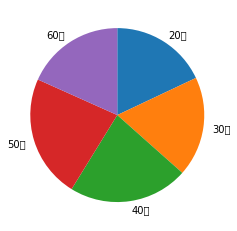

In [ ]:
values1 = [6944, 7180, 8589, 8847, 7068]
labels = ['20대', '30대', '40대', '50대', '60대']
plt.pie(values1,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 응답 연령대는 비교적 고르게 분포해 있다.

In [ ]:
print(len(df2.loc[df2['SEX'] == 'F']),
len(df2.loc[df2['SEX'] == 'M']))

19067 19561


<function matplotlib.pyplot.show(*args, **kw)>

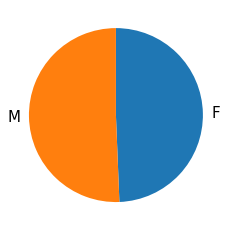

In [ ]:
values2 = [19067, 19561]
labels = ['F', 'M']
plt.pie(values2,labels = labels, startangle = 90, counterclock=False, textprops={'size':15})

plt.show # 응답 성별은 남성(51%), 여성(약 49%)으로 고르게 분포해 있다.

In [ ]:
print(len(df2.loc[df2['DO'] == '서울특별시']),
len(df2.loc[df2['DO'] == '경기도']),
len(df2.loc[df2['DO'] == '강원도']),
len(df2.loc[df2['DO'] == '충청남도']),
len(df2.loc[df2['DO'] == '부산광역시']),
len(df2.loc[df2['DO'] == '제주특별자치도']),
len(df2.loc[df2['DO'] == '대전광역시']),
len(df2.loc[df2['DO'] == '전라북도']),
len(df2.loc[df2['DO'] == '경상북도']),
len(df2.loc[df2['DO'] == '전라남도']),
len(df2.loc[df2['DO'] == '경상남도']),
len(df2.loc[df2['DO'] == '세종특별자치시']),
len(df2.loc[df2['DO'] == '인천광역시']),
len(df2.loc[df2['DO'] == '대구광역시']),
len(df2.loc[df2['DO'] == '광주광역시']),
len(df2.loc[df2['DO'] == '울산광역시']),
len(df2.loc[df2['DO'] == '충청북도']))

6928 9092 1206 1524 2773 539 1265 1290 2037 1264 2608 357 2399 1921 1202 947 1276


<function matplotlib.pyplot.show(*args, **kw)>

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49436 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50872 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 53945 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48324 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49884 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 49436 missing from current font.
  font.set_

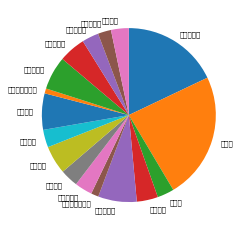

In [ ]:
values3 = [6928, 9092, 1206, 1524, 2773, 539, 1265, 1290, 2037, 1264, 2608, 357, 2399, 1921, 1202, 947, 1276]
labels = ['서울특별시', '경기도', '강원도', '충청남도', '부산광역시', '제주특별자치도', '대전광역시', '전라북도', '경상북도', '전라남도', '경상남도', '세종특별자치시', '인천광역시', '대구광역시', '광주광역시', '울산광역시', '충청북도']
plt.pie(values3,labels = labels, startangle = 90, counterclock=False, textprops={'size':7})

plt.show # 응답 지역은 서울특별시(약 18%), 경기도(약 24%)에 몰려 있고 이 외에는 대체로 3~5%대의 비율을 차지하고 있다.

In [ ]:
print(len(df2.loc[df2['MONEY'] == 1]),
len(df2.loc[df2['MONEY'] == 2]),
len(df2.loc[df2['MONEY'] == 3]),
len(df2.loc[df2['MONEY'] == 4]),
len(df2.loc[df2['MONEY'] == '무응답']))

9737 11798 7388 7734 1971


<function matplotlib.pyplot.show(*args, **kw)>

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47564 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48120 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47564 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 48120 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51060 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 51060 missing from current font.
  font.set_text

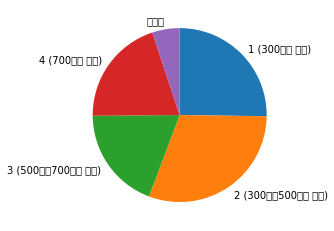

In [ ]:
values4 = [9737, 11798, 7388, 7734, 1971]
labels = ['1 (300만원 미만)', '2 (300이상500만원 미만)', '3 (500이상700만원 미만)', '4 (700만원 이상)', '무응답']
plt.pie(values4,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 소득 수준 또한 2(300이상 500만원 미만) 항목이 약 30%를 차지하는 등 비교적 고르게 분포해 있다.

따라서 응답자들의 분포는 연령대, 성별, 소득 수준에서 비교적 모든 항목에 고르게 분포해 있고, 지역 변수 중 "서울특별시"와 "경기도"에 많은 응답자들이 상대적으로 몰려 있는 것을 확인했으나, 두 지역이 대한민국에서 가장 인구밀집도가 높은 지역이라는 것을 고려해 크게 상관하지 않는다.

이후 다른 변수들도 확인하고자 했다.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 54217 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51068 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50668 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44032 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44036 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 54217 missing from current font.
  font.set_

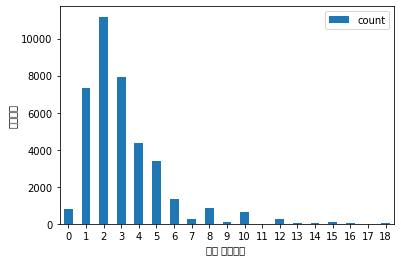

In [ ]:
answer1 = df2.groupby('WORKDAY', as_index = False).agg(count = ('WORKDAY', 'count'))
answer1.plot.bar(x="WORKDAY", y="count", rot = 0, xlabel = '평일 여가시간 ', ylabel = '응답자수')
# 주로 1~3시간 정도의 여유시간을 갖는다는 응답에 응답자들이 많이 몰려 있다.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47568 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47568 missing from current font.
  font.set_text(s, 0, flags=flags)


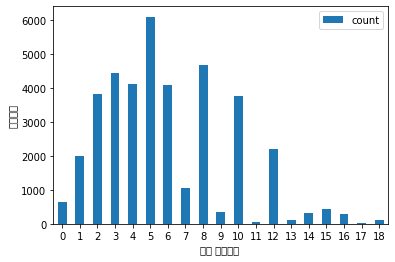

In [ ]:
answer2 = df2.groupby('WKEND', as_index = False).agg(count = ('WKEND', 'count'))
answer2.plot.bar(x="WKEND", y="count", rot = 0, xlabel = '주말 여가시간 ', ylabel = '응답자수')
# 주로 5시간 정도의 여유시간을 갖는다는 응답에 응답자들이 많이 몰려 있다.

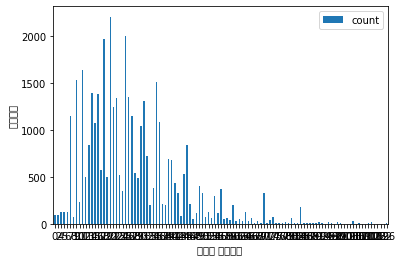

In [ ]:
answer3 = df2.groupby('ONEWEEK', as_index = False).agg(count = ('ONEWEEK', 'count'))
answer3.plot.bar(x="ONEWEEK", y="count", rot = 0, xlabel = '일주일 여가시간 ', ylabel = '응답자수')
# 그래프가 너무 촘촘해 알아볼 수가 없다. 따라서 수치를 통해 확인한다.

In [ ]:
count1 = df2['ONEWEEK'].value_counts()
print(count1[:10]) # 9~35시간대 에 많은 응답이 있었음을 알 수 있다.

20    2203
25    1995
18    1962
11    1639
9     1527
35    1511
14    1389
16    1379
26    1345
22    1334
Name: ONEWEEK, dtype: int64


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51473 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50724 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 46973 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48143 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 55092 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49885 missing from current font.
  font.set_

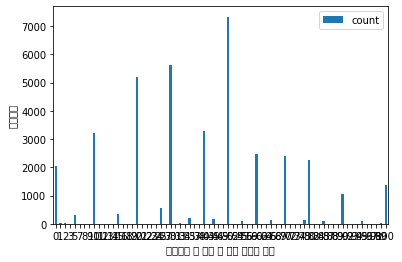

In [ ]:
answer4 = df2.groupby('REST', as_index = False).agg(count = ('REST', 'count'))
answer4.plot.bar(x="REST", y="count", rot = 0, xlabel = '여가시간 중 오락 및 휴식 활동의 비율', ylabel = '응답자수')
# 그래프가 너무 촘촘해 알아볼 수가 없다. 따라서 수치를 통해 확인한다.

In [ ]:
answer5 = np.mean(df2['REST'])
answer6 = np.mean(df2['HOBBY'])
answer7 = np.mean(df2['SELF'])
answer8 = np.mean(df2['SOCIAL'])
answer9 = np.mean(df2['ETC'])
print(f"여가시간 중 오락 및 휴식 활동의 비율 : {answer5} \n여가시간 중 취미 활동의 비율 : {answer6} \n여가시간 중 자기계발 활동의 비율 : {answer7}")
print(f"여가시간 중 소셜 활동의 비율 : {answer8} \n여가시간 중 기타 활동의 비율 : {answer9}")
# 평균적으로 여가시간 활동의 비율은 평균적으로 오락 및 휴식(41%),  소셜활동 (22%), 취미(19%), 자기계발(13%), 기타(3.24)와 같다.

여가시간 중 오락 및 휴식 활동의 비율 : 41.945945945945944 
여가시간 중 취미 활동의 비율 : 19.366884125504814 
여가시간 중 자기계발 활동의 비율 : 13.278606192399296
여가시간 중 소셜 활동의 비율 : 22.133840737289013 
여가시간 중 기타 활동의 비율 : 3.27472299886093


<function matplotlib.pyplot.show(*args, **kw)>

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 52712 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 52712 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44228 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48156 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 44228 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 48156 missing from current font.
  font.set_text

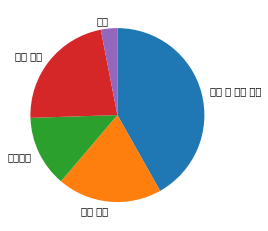

In [ ]:
values5 = [41, 19, 13, 22, 3]
labels = ['오락 및 휴식 활동', '취미 활동', '자기계발', '소셜 활동', '기타']
plt.pie(values5,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 응답자들은 평균적으로 여가시간의 41%를 오락 및 휴식활동에 투자한다.

### (2) 연령대별 분석
연령대별로 여가에 지출하는 정도와 미래 지출 정도가 차이가 있을까에 대해 확인한다.
- 현재 여가 비용 지출 정도에서는 20대가 가장 많고, 그 뒤로 점차 낮아진다.
- 미래 여가 비용 지출 의향 정도에서는 30대가 가장 많고 그 뒤로 점차 낮아진다. 그러나 그 정도가 크게 차이나지는 않는다.
- 이를 통해 20대는 비교적 여가를 중요시하고 이에 대한 지출을 아끼지 않는 편임을 알 수 있다.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50672 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47161 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 50672 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47161 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 54788 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51116 missing from current font.
  font.set_text

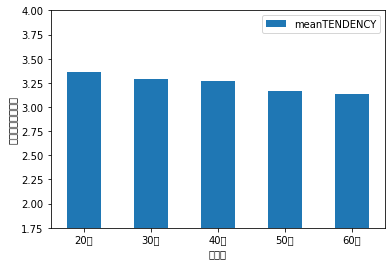

In [ ]:
age_TENDENCY = df2.groupby('AGE', as_index = False).agg(meanTENDENCY = ('TENDENCY', 'mean'))
age_TENDENCY
age_TENDENCY.plot.bar(x='AGE', y = 'meanTENDENCY', rot = 0, ylim = [1.75, 4], xlabel = '연령대', ylabel = '현재여가비용지출')

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47000 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47000 missing from current font.
  font.set_text(s, 0, flags=flags)


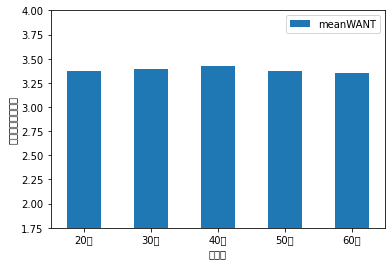

In [ ]:
age_WANT = df2.groupby('AGE', as_index = False).agg(meanWANT = ('WANT', 'mean'))
age_WANT.plot.bar(x = 'AGE', y = 'meanWANT', rot = 0, ylim = [1.75, 4], xlabel = '연령대', ylabel = '미래여가비용지출')

연령대별로 여가를 보내는 시간이 다른지 확인한다.
- 주로 직업을 가지고 일을 하는 연령대인 30~50대는 주중에는 상대적으로 여가를 많이 즐기지 못하고 있다.
- 반면 아직 취직을 하지 않은 20대나 은퇴를 한 60대는 주중에 비교적 여가를 많이 즐기고 있다.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44512 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47112 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51200 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44050 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 44512 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47112 missing from current font.
  font.set_te

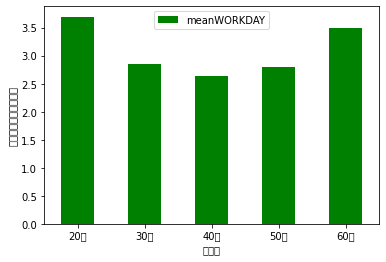

In [ ]:
age_WORKDAY = df2.groupby('AGE', as_index = False).agg(meanWORKDAY = ('WORKDAY', 'mean'))
age_WORKDAY.plot.bar(x = 'AGE', y = 'meanWORKDAY', rot = 0, xlabel = '연령대', ylabel = '평일일평균레저시간값', color = 'green')

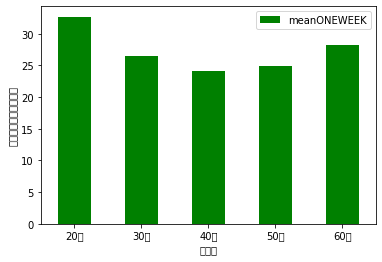

In [ ]:
age_ONEWEEK = df2.groupby('AGE', as_index = False).agg(meanONEWEEK = ('ONEWEEK', 'mean'))
age_ONEWEEK.plot.bar(x = 'AGE', y = 'meanONEWEEK', rot = 0, xlabel = '연령대', ylabel = '일주일평균레저시간값', color = 'green')
plt.savefig('./age_ONEWEEK.png')

### (3) 성별 분석

In [ ]:
!pip install mglearn 
!pip install --upgrade joblib==1.1.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 540 kB 5.0 MB/s 
  Created wheel for mglearn: filename=mglearn-0.1.9-py2.py3-none-any.whl size=582637 sha256=f454f9f2c2c5ace50dcfc81005bffa09affd4b1cc615c5bf7ccf2f78a7ad3af1
  Stored in directory: /root/.cache/pip/wheels/f1/17/e1/1720d6dcd70187b6b6c3750cb3508798f2b1d57c9d3214b08b
Successfully built mglearn
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 306 kB 5.0 MB/s 
  Attempting uninstall: joblib
    Found existing installation: joblib 1.2.0
    Uninstalling joblib-1.2.0:
      Successfully uninstalled joblib-1.2.0


In [ ]:
import mglearn
plt.rcParams["font.size"] = 12 #폰트 사이즈 전역 설정

성별과 연령대를 동시에 이용해 해당 집단 간에 차이가 있는지 확인한다.
- 여가 관련 투자 정도에는 연령대별로 남성이 여성에 비해 현재 여가 관련 비용 지출이 많다고 응답했지만, 수치가 작아 확신할 수 없다.
- 남성과 여성 모두 점차 연령대가 높아질 수록 여가에 관한 비용 지출을 줄고 있다.
-남성과 여성 모두 미래 여가 관련 비용 지출 의향은 30대에서 높아지는 모습을 보여주고 있다.

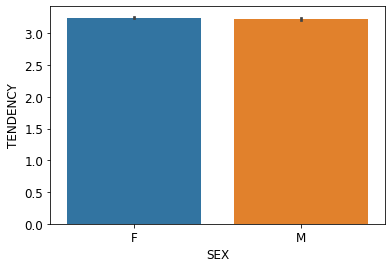

In [ ]:
sns.barplot(x="SEX", y="TENDENCY",data=df2)
# 성별 간 여가 활동 현재 지출 의향

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


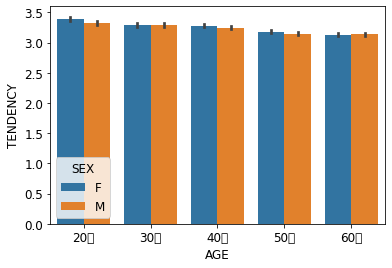

In [ ]:
sns.barplot(x="AGE", y="TENDENCY",hue='SEX', data=df2, order = ['20대', '30대', '40대', '50대', '60대'])
# 연령대별 - 성별로 여가 활동 현재 지출 의향

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


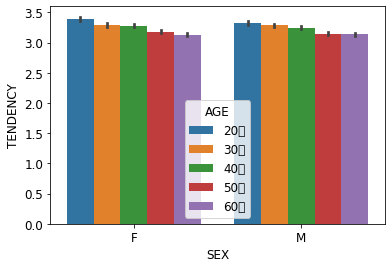

In [ ]:
sns.barplot(x="SEX", y="TENDENCY", hue='AGE', data=df2, hue_order = ['20대', '30대', '40대', '50대', '60대'])
# 성별 - 연령대별로 여가활동 현재 지출 의향

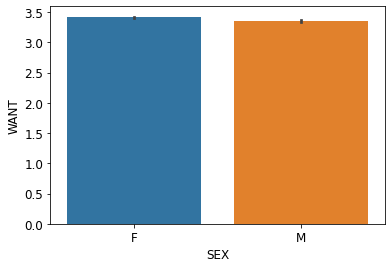

In [ ]:
sns.barplot(x="SEX", y="WANT",data=df2)
# 성별 간 여가 활동 미래 지출 의향

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


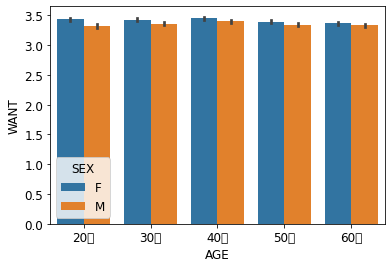

In [ ]:
sns.barplot(x="AGE", y="WANT",hue='SEX', data=df2, order = ['20대', '30대', '40대', '50대', '60대'])
# 연령대별 - 성별로 여가활동 미래 지출 의향

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


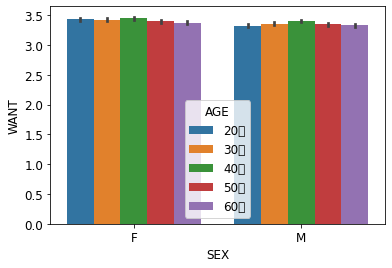

In [ ]:
sns.barplot(x="SEX", y="WANT", hue='AGE', data=df2, hue_order = ['20대', '30대', '40대', '50대', '60대'])
# 성별 - 연령대별로 여가활동 미래 지출 의향

### (4) 주소지별 분석
- 세종특별자치시의 여가활동에 대한 현재, 미래 지출 의향이 타 주소지에 비해 크지만 이 수치가 매우 작아 의미 있는 결과로 보기는 힘들다.
- 따라서 지역간에는 여가 활동 지출 의향 간에 차이가 있다고 보기는 어렵다.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 <a list of 17 Text major ticklabel objects>)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49436 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50872 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 53945 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48324 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49884 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44221 missing from current font.
  font.set_

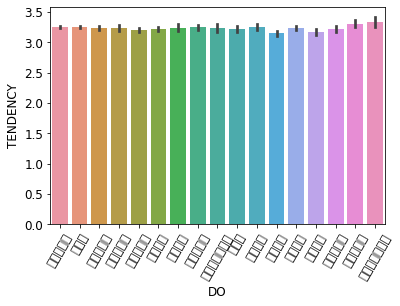

In [ ]:
sns.barplot(x="DO", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
# 주소지 별로 여가 활동 현재 지출 의향

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 <a list of 17 Text major ticklabel objects>)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49436 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 50872 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 53945 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 48324 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49884 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44221 missing from current font.
  font.set_

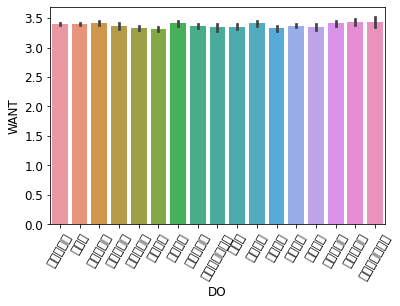

In [ ]:
sns.barplot(x="DO", y="WANT", data=df2)
plt.xticks(rotation=60)
# 주소지 별로 여가 활동 미래 지출 의향

### (5) 소득별 분석
- 소득 수준이 높아질수록 여가활동에 대한 미래 지출 의향이 커지지만, 이 수치가 매우 작아 충분히 의미 있다고 여기기에는 힘들다
- 소득별로 연령대를 나눴을 때, 여가 관련 현재 지출이 가장 많다고 응답한 것은 20대이며 연령대가 높아질 수록 이 수치가 낮아진다.


In [ ]:
df2["MONEY"].value_counts() # 무응답 값은 약 5% 정도로, 그 영향이 크지 않다.

2      11798
1       9737
4       7734
3       7388
무응답     1971
Name: MONEY, dtype: int64

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 47924 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 51025 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45813 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 47924 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 51025 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45813 missing from current font.
  font.set_text

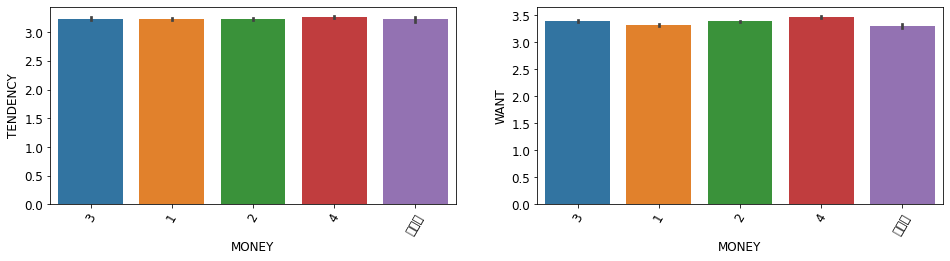

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
sns.barplot(x="MONEY", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
# 소득별로 여가 활동 현재 지출 의향

plt.subplot(2, 2, 2)
sns.barplot(x="MONEY", y="WANT", data=df2)
plt.xticks(rotation=60)
# 소득별로 여가 활동 현재 지출 의향

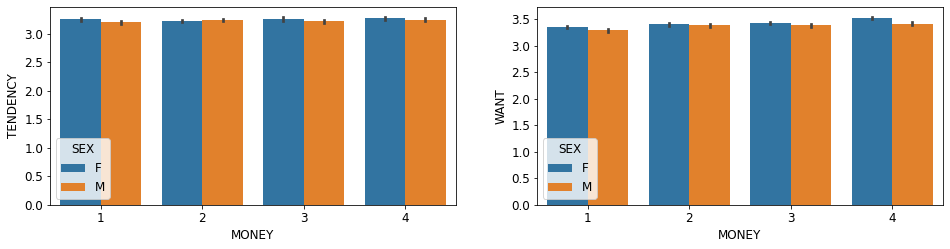

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
not_x = df2['MONEY'] != '무응답'
sns.barplot(x="MONEY", y="TENDENCY", hue='SEX', data=df2[not_x]) # 소득 - 성별별로 여가 활동 현재 지출 의향

plt.subplot(2, 2, 2)
not_x = df2['MONEY'] != '무응답'
sns.barplot(x="MONEY", y="WANT", hue='SEX', data=df2[not_x]) # 소득 - 성별별로 여가 활동 미래 지출 의향

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 45824 missing from current font.
  font.set_text(s, 0, flags=flags)


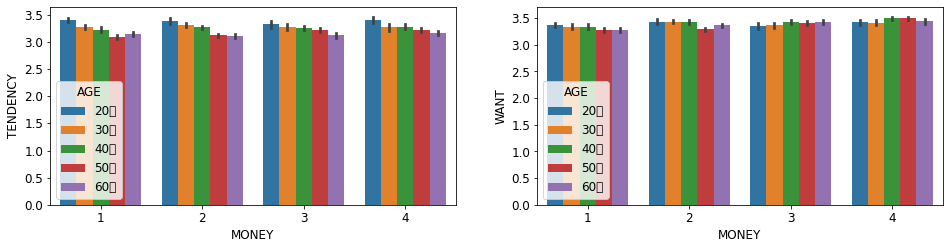

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
sns.barplot(x="MONEY", y="TENDENCY", hue='AGE', data=df2[not_x], hue_order = ['20대', '30대', '40대', '50대', '60대']) # 소득 - 연령별로 여가 활동 현재 지출 의향

plt.subplot(2, 2, 2)
sns.barplot(x="MONEY", y="WANT", hue='AGE', data=df2[not_x], hue_order = ['20대', '30대', '40대', '50대', '60대']) # 소득 - 연령별로 여가 활동 현재 지출 의향

### (6) 관심도별 분석
- 어떤 관심도이든 관심 수준이 올라갈 수록, 현재 여가 지출 비용과 미래 여가 지출 희망 비용이 증가한다.
- 따라서 여가 활동에 관심이 많은 사람일 수록 여가 활동에 더 적극적일 것이다.

In [ ]:
import matplotlib.pyplot as plt

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

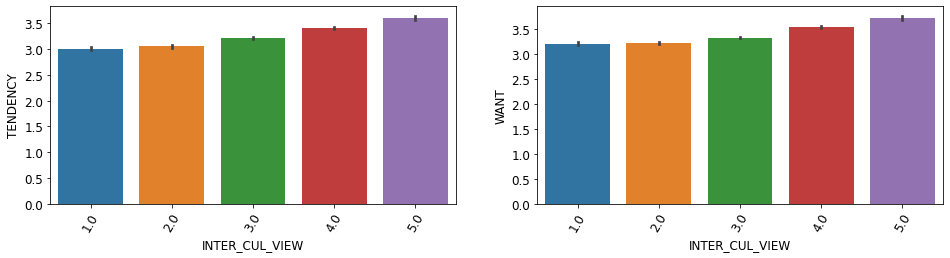

In [ ]:
# 문화예술관람관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_CUL_VIEW", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_CUL_VIEW", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

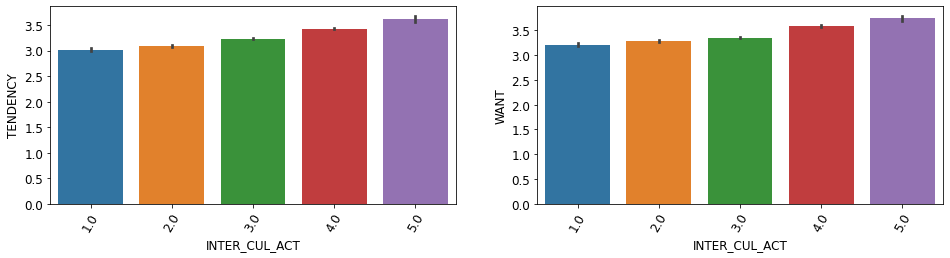

In [ ]:
# 문화예술활동관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_CUL_ACT", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_CUL_ACT", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

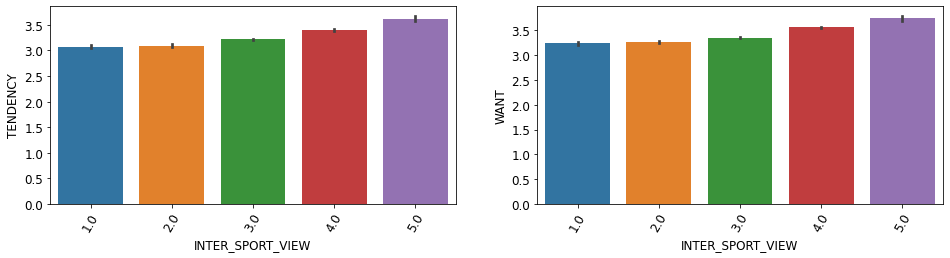

In [ ]:
# 스포츠관람관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SPORT_VIEW", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SPORT_VIEW", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

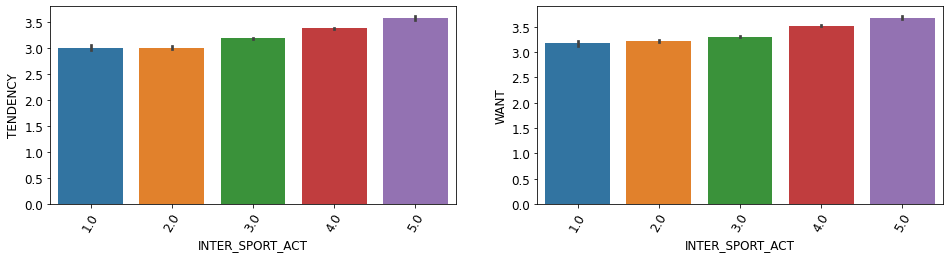

In [ ]:
# 스포츠활동관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SPORT_ACT", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SPORT_ACT", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

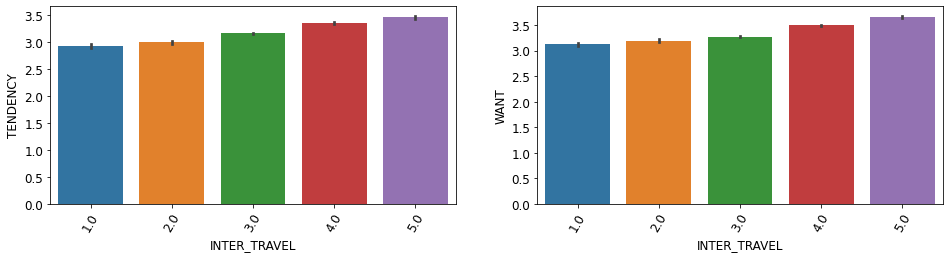

In [ ]:
# 관광여행관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_TRAVEL", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_TRAVEL", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

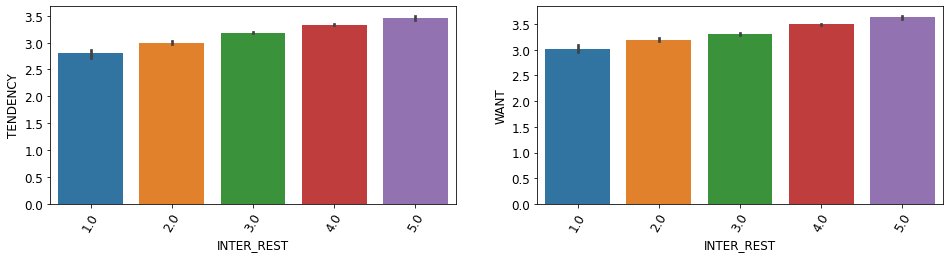

In [ ]:
# 오락휴식관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_REST", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_REST", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

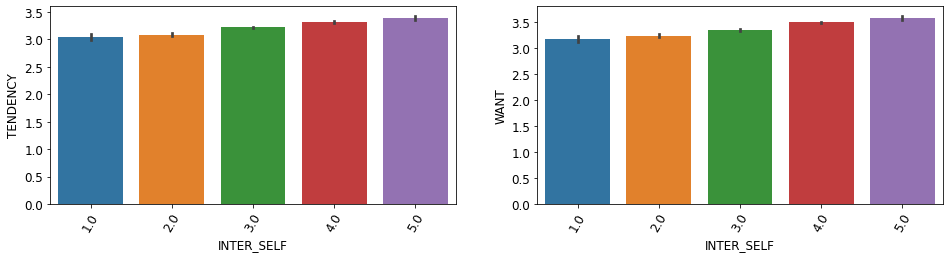

In [ ]:
# 본인계발본인관리관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SELF", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SELF", y="WANT", data=df2)
plt.xticks(rotation=60)

(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

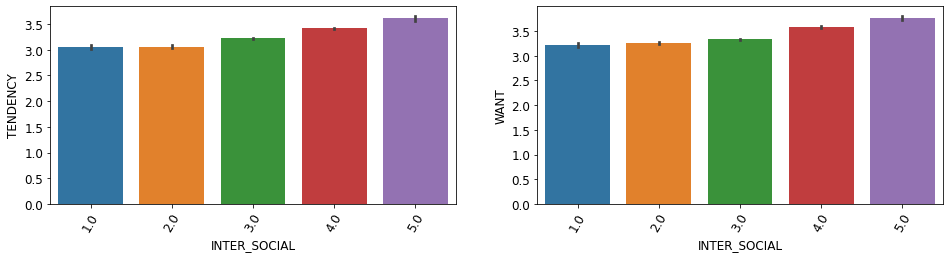

In [ ]:
# 사회교류관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SOCIAL", y="TENDENCY", data=df2)
plt.xticks(rotation=60)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SOCIAL", y="WANT", data=df2)
plt.xticks(rotation=60)

해당 관심도는 각각 "관심 종류"별로 나눠 설문된 것이다. 따라서 "여가활동" 자체에 대한 평균 관심도를 구할 필요가 있어 새로운 변수를 만들고자 한다.

In [ ]:
df3 = df2.copy() #평균 여가 활동 관심도 변수 추가
df3['INTEREST'] = (df2['INTER_CUL_VIEW'] +df2['INTER_CUL_ACT']+df2['INTER_SPORT_VIEW']+df2['INTER_SPORT_ACT']+df2['INTER_TRAVEL']+df2['INTER_REST']+df2['INTER_SELF']+df2['INTER_SOCIAL'])/8

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]),
 <a list of 33 Text major ticklabel objects>)

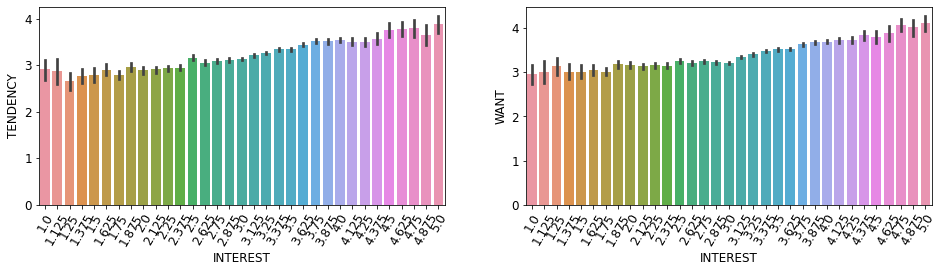

In [ ]:
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTEREST", y="TENDENCY", data=df3)
plt.xticks(rotation=60)
plt.subplot(2, 2, 2)
sns.barplot(x="INTEREST", y="WANT", data=df3)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]),
 <a list of 33 Text major ticklabel objects>)

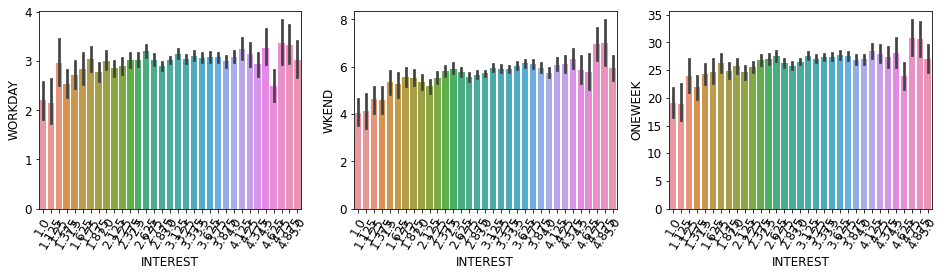

In [ ]:
plt.figure(figsize = (16, 8))
plt.subplot(2, 3, 1)
sns.barplot(x="INTEREST", y="WORKDAY", data=df3)
plt.xticks(rotation=60)
plt.subplot(2, 3, 2)
sns.barplot(x="INTEREST", y="WKEND", data=df3)
plt.xticks(rotation=60)
plt.subplot(2, 3, 3)
sns.barplot(x="INTEREST", y="ONEWEEK", data=df3)
plt.xticks(rotation=60)

## [4] 데이터 분석

상관관계 분석
앞에서 중요하게 여겼던 TENDENCY & WANT와 상관관계가 높은 변수가 있는지 확인한다. (단 상관관계는 주로 상관계수 자체가 선형성의 강도가 얼마나 강한지를 보여주는 수치이기 때문에 직선 형태가 아닐 경우 정확도가 매우 떨어질 수 있음을 유의한다.)

In [ ]:
df_corr = df3.corr()
df_corr

,DATE,TENDENCY,WANT,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
DATE,1.000000,0.110066,0.042420,-0.011998,-0.029234,-0.021666,-0.054903,0.036520,-0.002842,0.020318,0.030479,0.116489,0.075278,0.088391,0.079982,0.113211,0.008738,0.000444,0.128437,0.115198
TENDENCY,0.110066,1.000000,0.430579,0.030673,0.077927,0.057047,-0.075508,0.035974,-0.031540,0.079625,0.016678,0.190569,0.178561,0.153073,0.191582,0.207578,0.167961,0.107587,0.176632,0.252889
WANT,0.042420,0.430579,1.000000,-0.014878,0.040947,0.007811,-0.076569,0.023551,-0.002629,0.070452,0.016495,0.184652,0.175595,0.164082,0.190009,0.227114,0.184981,0.144246,0.187783,0.268192
WORKDAY,-0.011998,0.030673,-0.014878,1.000000,0.451156,0.916658,0.038048,-0.022858,0.006269,-0.019518,-0.022045,0.024914,0.023501,0.011364,0.017098,0.006168,0.044166,0.031830,0.008919,0.029616
WKEND,-0.029234,0.077927,0.040947,0.451156,1.000000,0.770241,0.052014,-0.044461,-0.057792,0.034913,-0.020462,0.043739,0.014782,0.023642,0.027864,0.084590,0.101128,0.049061,0.013514,0.065526
ONEWEEK,-0.021666,0.057047,0.007811,0.916658,0.770241,1.000000,0.050484,-0.036246,-0.021402,0.001688,-0.024917,0.037524,0.023466,0.018779,0.024782,0.042526,0.077149,0.044867,0.012467,0.050703
REST,-0.054903,-0.075508,-0.076569,0.038048,0.052014,0.050484,1.000000,-0.497004,-0.379972,-0.415675,-0.199488,-0.085816,-0.117029,-0.086609,-0.173008,-0.051847,0.110728,-0.121680,-0.159683,-0.127592
HOBBY,0.036520,0.035974,0.023551,-0.022858,-0.044461,-0.036246,-0.497004,1.000000,-0.071877,-0.202813,-0.136289,0.061252,0.078191,0.103145,0.229184,0.019598,-0.067056,0.010463,0.030685,0.086709
SELF,-0.002842,-0.031540,-0.002629,0.006269,-0.057792,-0.021402,-0.379972,-0.071877,1.000000,-0.164175,-0.096498,0.062860,0.102033,0.009020,0.019428,-0.024088,-0.051541,0.260771,0.014101,0.069081
SOCIAL,0.020318,0.079625,0.070452,-0.019518,0.034913,0.001688,-0.415675,-0.202813,-0.164175,1.000000,-0.144688,0.031079,0.021074,0.027325,0.001843,0.081498,0.002774,-0.024394,0.199588,0.065146


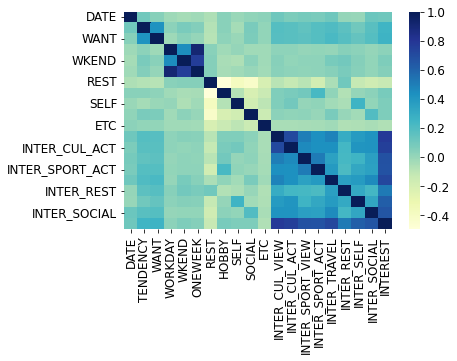

In [ ]:
sns.heatmap(df_corr, cmap="YlGnBu")
plt.show() 
#INTERST 변수는 INTER_ 변수로부터 만들어진 파생변수이므로, 해당 변수들과 상관 관계가 높다.
# WORKDAY, WKEND, ONEWEEK 또한 높은 상관 관계가 있다.
# WANT와 TENDENCY도 상관관계가 높다.

In [ ]:
df_corr["TENDENCY"].sort_values(ascending = False)
# 현재 여가에 얼마나 돈을 지출하는가에 가장 큰 영향을 미치는 것은 WANT이며, 그 뒤로 INTERST가 뒤따른다.

TENDENCY            1.000000
WANT                0.430579
INTEREST            0.252889
INTER_TRAVEL        0.207578
INTER_SPORT_ACT     0.191582
INTER_CUL_VIEW      0.190569
INTER_CUL_ACT       0.178561
INTER_SOCIAL        0.176632
INTER_REST          0.167961
INTER_SPORT_VIEW    0.153073
DATE                0.110066
INTER_SELF          0.107587
SOCIAL              0.079625
WKEND               0.077927
ONEWEEK             0.057047
HOBBY               0.035974
WORKDAY             0.030673
ETC                 0.016678
SELF               -0.031540
REST               -0.075508
Name: TENDENCY, dtype: float64

In [ ]:
df_corr["WANT"].sort_values(ascending = False) #

WANT                1.000000
TENDENCY            0.430579
INTEREST            0.268192
INTER_TRAVEL        0.227114
INTER_SPORT_ACT     0.190009
INTER_SOCIAL        0.187783
INTER_REST          0.184981
INTER_CUL_VIEW      0.184652
INTER_CUL_ACT       0.175595
INTER_SPORT_VIEW    0.164082
INTER_SELF          0.144246
SOCIAL              0.070452
DATE                0.042420
WKEND               0.040947
HOBBY               0.023551
ETC                 0.016495
ONEWEEK             0.007811
SELF               -0.002629
WORKDAY            -0.014878
REST               -0.076569
Name: WANT, dtype: float64

In [ ]:
df_corr["WORKDAY"].sort_values(ascending = False)

WORKDAY             1.000000
ONEWEEK             0.916658
WKEND               0.451156
INTER_REST          0.044166
REST                0.038048
INTER_SELF          0.031830
TENDENCY            0.030673
INTEREST            0.029616
INTER_CUL_VIEW      0.024914
INTER_CUL_ACT       0.023501
INTER_SPORT_ACT     0.017098
INTER_SPORT_VIEW    0.011364
INTER_SOCIAL        0.008919
SELF                0.006269
INTER_TRAVEL        0.006168
DATE               -0.011998
WANT               -0.014878
SOCIAL             -0.019518
ETC                -0.022045
HOBBY              -0.022858
Name: WORKDAY, dtype: float64

In [ ]:
df_corr["WKEND"].sort_values(ascending = False) #REST의 상관관계가 WORKDAY(3.8%)에서 5%로 증가했으나, 그 순위는 낮아졌다.
# 수치가 낮아 유의미하다고 할 수 없지만, WORKDAY에 비해 5~10% 상관계수를 갖고 있는 변수가 증가 했다.

WKEND               1.000000
ONEWEEK             0.770241
WORKDAY             0.451156
INTER_REST          0.101128
INTER_TRAVEL        0.084590
TENDENCY            0.077927
INTEREST            0.065526
REST                0.052014
INTER_SELF          0.049061
INTER_CUL_VIEW      0.043739
WANT                0.040947
SOCIAL              0.034913
INTER_SPORT_ACT     0.027864
INTER_SPORT_VIEW    0.023642
INTER_CUL_ACT       0.014782
INTER_SOCIAL        0.013514
ETC                -0.020462
DATE               -0.029234
HOBBY              -0.044461
SELF               -0.057792
Name: WKEND, dtype: float64

In [ ]:
df_corr["ONEWEEK"].sort_values(ascending = False)

ONEWEEK             1.000000
WORKDAY             0.916658
WKEND               0.770241
INTER_REST          0.077149
TENDENCY            0.057047
INTEREST            0.050703
REST                0.050484
INTER_SELF          0.044867
INTER_TRAVEL        0.042526
INTER_CUL_VIEW      0.037524
INTER_SPORT_ACT     0.024782
INTER_CUL_ACT       0.023466
INTER_SPORT_VIEW    0.018779
INTER_SOCIAL        0.012467
WANT                0.007811
SOCIAL              0.001688
SELF               -0.021402
DATE               -0.021666
ETC                -0.024917
HOBBY              -0.036246
Name: ONEWEEK, dtype: float64

In [ ]:
df_corr["INTEREST"].sort_values(ascending = False)
# INTEREST 변수는 파생변수라 INTER_로 시작하는 변수들의 상관계수가 매우 높다.
# 이 때 문화와 여행 관련 변수가 가장 상관계수가 높고 (70%대), 그 다음으로 SPORT와  SOCIAL (60%대), REST가 가장 낮은 상관계수를 갖고 있다. (50%대)

INTEREST            1.000000
INTER_CUL_VIEW      0.785525
INTER_CUL_ACT       0.760714
INTER_TRAVEL        0.730046
INTER_SPORT_VIEW    0.680360
INTER_SPORT_ACT     0.678278
INTER_SOCIAL        0.664914
INTER_SELF          0.621258
INTER_REST          0.522243
WANT                0.268192
TENDENCY            0.252889
DATE                0.115198
HOBBY               0.086709
SELF                0.069081
WKEND               0.065526
SOCIAL              0.065146
ONEWEEK             0.050703
WORKDAY             0.029616
ETC                -0.059606
REST               -0.127592
Name: INTEREST, dtype: float64

변수 TENDENCY와 WANT 변수에 있어서 INTEREST(여가시간 활동에 대해 관심을 갖는 정도)의 상관계수가 25%로, 약한 양의 상관관계가 있다고 볼 수 있다. 따라서 이후 3가지 변수를 중점적으로 다루고자 한다.

## [5] 모델링

### (1) 데이터 분리

모델링을 위한 데이터(모델링 & 검증)와 모델을 통해 NAN값을 얻고자 하는 데이터(TENDENCY와 WANT가 NAN인 데이터) 로 분리한다.

In [ ]:
df4 = df3.copy() #문자를 숫자로 대체
df4 = df4.replace({'서울특별시':1, '경기도':2, '인천광역시':3, '대전광역시':4, '부산광역시':5, '경상북도':6, '충청북도':7, '대구광역시':8, '제주특별자치도':9, '강원도':10, '충청남도':11, '전라북도':12, '경상남도':13, '전라남도':14, '광주광역시':15, '울산광역시':16, '세종특별자치시' :17})
df4 = df4.replace({'20대':2, '30대':3, '40대':4, '50대':5,'60대':6})
df4 = df4.replace({'M':1, 'F':2})
df4

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
0,53322319,20220824,2,5,1,3,3.0,3.0,4,6,...,0,4.0,4.0,3.0,3.0,5.0,3.0,4.0,3.0,3.625
1,53322352,20220824,2,5,1,3,4.0,3.0,2,2,...,0,2.0,3.0,3.0,4.0,3.0,3.0,4.0,3.0,3.125
2,53322506,20220824,1,2,1,1,4.0,2.0,3,7,...,0,3.0,2.0,1.0,3.0,3.0,4.0,3.0,2.0,2.625
3,53322878,20220824,2,6,1,1,3.0,2.0,3,5,...,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.000
4,53322944,20220824,2,6,1,2,3.0,4.0,1,2,...,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,4.0,3.125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3230048,20211222,1,2,1,2,NaN,NaN,2,4,...,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3238610,20211222,2,2,16,1,NaN,NaN,5,10,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3239449,20211222,1,3,10,1,NaN,NaN,2,5,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3242506,20211222,1,5,2,4,NaN,NaN,4,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_miss = df4[df4['TENDENCY'].isnull()] #TENDENCY와 WANT모두 동일한 행에 동일하게 없기 때문에 변수 하나만 사용한다.
# 모두 7216개인 것을 확인
df_miss #[283]보다 먼저 실행되어야 함!!!!!!!!!

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
31412,1051,20211201,1,5,14,1,NaN,NaN,4,14,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31413,1384,20211201,1,4,5,4,NaN,NaN,2,5,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31414,2397,20211201,1,5,15,4,NaN,NaN,6,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31415,2664,20211201,1,5,14,1,NaN,NaN,5,15,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31416,3239,20211201,1,6,14,3,NaN,NaN,16,16,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3230048,20211222,1,2,1,2,NaN,NaN,2,4,...,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3238610,20211222,2,2,16,1,NaN,NaN,5,10,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3239449,20211222,1,3,10,1,NaN,NaN,2,5,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3242506,20211222,1,5,2,4,NaN,NaN,4,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df5 = df4.copy()
df5['MONEY'] = df5['MONEY'].replace('무응답', np.nan)
df5 = df5.dropna(axis=0) #NAN값을 제거한 모델생성/테스트 프레임

In [ ]:
df_find = df5.copy()
df_find = df_find.dropna(axis=0)

In [ ]:
# NAN값을 추측하고자 하는 데이터는 TENDENCY와 WANT 모두 존재 X
df_mt = df_find.drop(['WANT'], axis =1) # TENDENCY 예측 위한
df_mw = df_find.drop(['TENDENCY'], axis = 1) # WANT 예측 위한

### (2) 의사결정나무를 이용한 모델링

#### a. TENDENCY 예측

##### 1. 모델링 과정

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

In [ ]:
df_mtt = df_mt.drop(['RESPOND_ID', 'DATE'], axis=1) # 필요없는 변수 삭제

In [ ]:
df_mtt = df_mtt[['TENDENCY', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK',
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
x = df_mtt.iloc[:, 1:]
y = df_mtt["TENDENCY"]

# 데이터셋을 학습(train)과 테스트(test) 세트로 분할
# random_state : random 으로 분할시 사용되는 난수 seed 숫자
#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, stratify=y, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state=42)

tree = DecisionTreeClassifier(random_state=0)  

tree.fit(X_train, y_train) #학습한다는 뜻
print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.748


In [ ]:
# 의사결정나무의 깊이를 10로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=10, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.628
시험용 데이터 정확도: 0.539


In [ ]:
# 의사결정나무의 깊이를 20로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=20, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.971
시험용 데이터 정확도: 0.728


In [ ]:
# 의사결정나무의 깊이를 32로 제한하면 시험용 데이터에 대한 성능이 향상됨 (과적합을 줄임)
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=32, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.999
시험용 데이터 정확도: 0.750


In [ ]:
# 의사결정나무의 깊이를 40로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=40, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.748


In [ ]:
#graphviz 라이브러리를 이용하여 의사결정나무 그리기 
from sklearn.tree import export_graphviz
import graphviz

In [ ]:
# filled = True: 색상의 진하기로 클래스를 나타냄, impurity: 불순도 계산값 보여주기 옵션
### export_graphviz(tree(tree 넣어야 함), out_file="tree.dot", class_names=[ (왼쪽)"양성", (오른쪽)"악성"],
###             feature_names=wisc.columns[1:], impurity=False, filled=True)

export_graphviz(tree, out_file="tree.dot", class_names=[ '1.0', '2.0', '3.0', '4.0', '5.0'],
                feature_names=df_mtt.columns[1:], impurity=False, filled=True)

with open("tree.dot") as f:
    dot_graph = f.read()

display(graphviz.Source(dot_graph))

In [ ]:
result = tree.feature_importances_
print("변수의 중요도:\n", result)

변수의 중요도:
 [0.02072041 0.04863688 0.09225182 0.04688932 0.0423056  0.07401817
 0.098829   0.07061486 0.06772834 0.0604828  0.06144192 0.02125355
 0.03046975 0.03010685 0.03881054 0.04231334 0.04257944 0.02965578
 0.04112949 0.03976215]


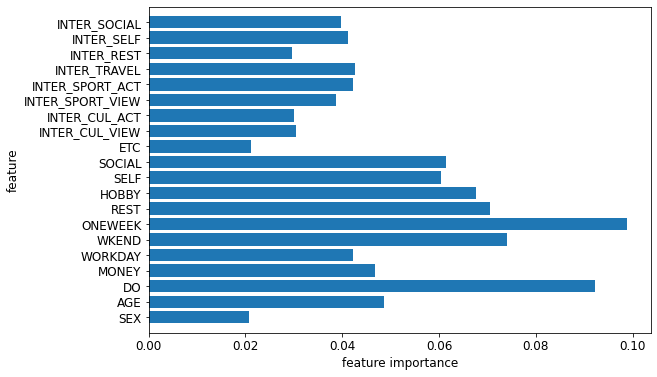

In [ ]:
import numpy as np

def plot_feature_importances_wisc(model):
    plt.rcParams["figure.figsize"] = (9,6)
    n_features = len(df_mtt.columns[1:])  # 'TENDENCY'를 제외한 나머지'
    plt.barh(np.arange(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), df_mtt.columns[1:])   # 눈금을 표시하고 눈금 레이블을 변수 이름으로 지정
    plt.xlabel("feature importance")
    plt.ylabel("feature")
    plt.ylim(-1, n_features) #Y 축 범위 지정

plot_feature_importances_wisc(tree)

In [ ]:
res = pd.DataFrame(result)
res["name"] = df_mtt.columns[1:]
display(res.info())

# perimeter_worst의 비중이 가장 큼, 루트 노드에서 이 값부터 사용 
display(res.sort_values(by='name'))  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       20 non-null     float64
 1   name    20 non-null     object 
dtypes: float64(1), object(1)
memory usage: 448.0+ bytes


None

,0,name
1,0.048637,AGE
2,0.092252,DO
11,0.021254,ETC
8,0.067728,HOBBY
13,0.030107,INTER_CUL_ACT
12,0.030470,INTER_CUL_VIEW
17,0.029656,INTER_REST
18,0.041129,INTER_SELF
19,0.039762,INTER_SOCIAL
15,0.042313,INTER_SPORT_ACT


##### 교차 검증 : 0.701

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.datasets import load_iris

In [ ]:
# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5
dt_scores = cross_val_score(tree, X_train, y_train, cv=10, scoring='accuracy')  

In [ ]:
print("Decision tree: ", dt_scores)
print("Decision tree :{:.3f}".format(dt_scores.mean()))  # 평균

Decision tree:  [0.70873321 0.71641075 0.69433781 0.70345489 0.70009597 0.70283245
 0.69899184 0.69611138 0.69467115 0.69611138]
Decision tree :0.701


In [ ]:
from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
print(kf)

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)


In [ ]:
dt_scores = cross_val_score(tree, X_train, y_train, cv=kf, scoring='accuracy')
print("Accuracy mean -- StratifiedKFold 이용")
print("Decision tree :{:.3f}".format(dt_scores.mean())) 

Accuracy mean -- StratifiedKFold 이용
Decision tree :0.701


##### 그리드 서치 : 0.784
'learning_rate': 0.1, 'max_depth': 10

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_breast_cancer
from sklearn.ensemble import GradientBoostingClassifier
# 파라미터를 dictionary 형태로 설정 # 엄청나게 오래 걸림... 100분,...
parameters = {'max_depth':[10, 20, 32], 'learning_rate':[0.8, 0.1, 0.2]}

In [ ]:
# param_grid의 파라미터들을 3개의 fold 로 나누어 검증
# refit=True (기본값): 가장 좋은 파라미터 설정으로 재학습  
init_gbrt = GradientBoostingClassifier(random_state=0)
grid_gbrt = GridSearchCV(init_gbrt, param_grid=parameters, cv=3, refit=True)
print(grid_gbrt)
# 파라미터들을 순차적으로 학습, 검증
grid_gbrt.fit(X_train, y_train)

# GridSearchCV 결과 추출하여 DataFrame으로 변환
scores_df = pd.DataFrame(grid_gbrt.cv_results_)
scores_df[['params', 'mean_test_score', 'rank_test_score', 'split0_test_score', 'split1_test_score', 'split2_test_score']]

GridSearchCV(cv=3, estimator=GradientBoostingClassifier(random_state=0),
             param_grid={'learning_rate': [0.8, 0.1, 0.2],
                         'max_depth': [10, 20, 32]})


,params,mean_test_score,rank_test_score,split0_test_score,split1_test_score,split2_test_score
0,"{'learning_rate': 0.8, 'max_depth': 10}",0.667771,4,0.676458,0.655004,0.671850
1,"{'learning_rate': 0.8, 'max_depth': 20}",0.663451,6,0.666235,0.661051,0.663067
2,"{'learning_rate': 0.8, 'max_depth': 32}",0.646124,8,0.647516,0.646796,0.644060
3,"{'learning_rate': 0.1, 'max_depth': 10}",0.685721,1,0.690569,0.680058,0.686537
4,"{'learning_rate': 0.1, 'max_depth': 20}",0.667243,5,0.670842,0.668251,0.662635
5,"{'learning_rate': 0.1, 'max_depth': 32}",0.646028,9,0.643485,0.653276,0.641325
6,"{'learning_rate': 0.2, 'max_depth': 10}",0.683369,2,0.685529,0.681785,0.682793
7,"{'learning_rate': 0.2, 'max_depth': 20}",0.673962,3,0.676602,0.667387,0.677898
8,"{'learning_rate': 0.2, 'max_depth': 32}",0.646220,7,0.643629,0.648668,0.646364


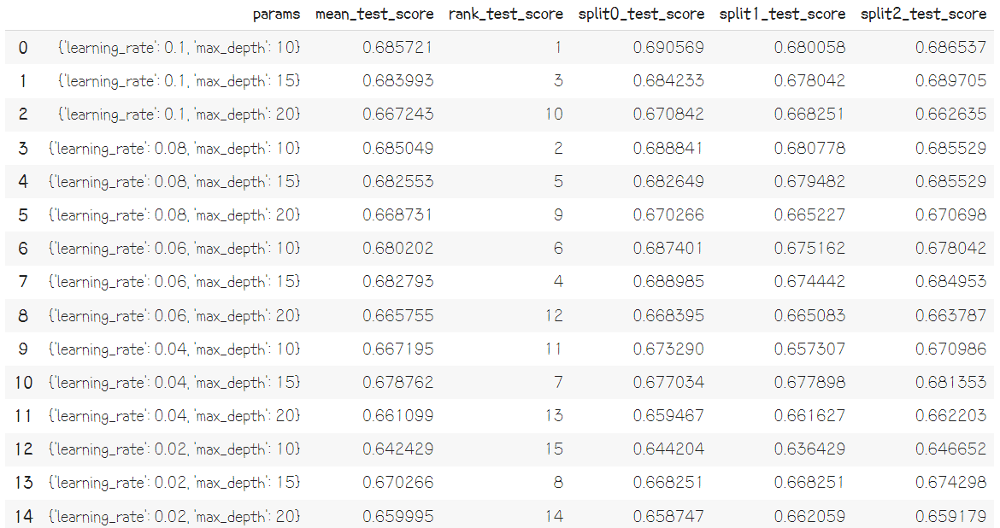

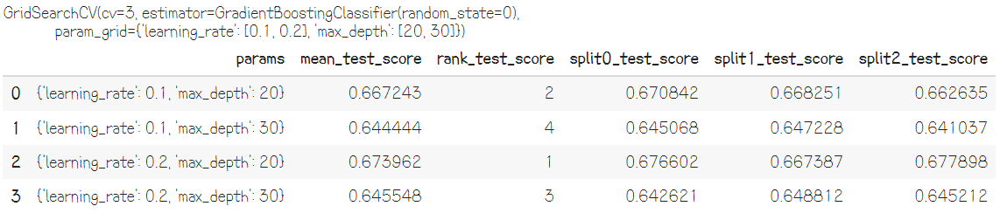

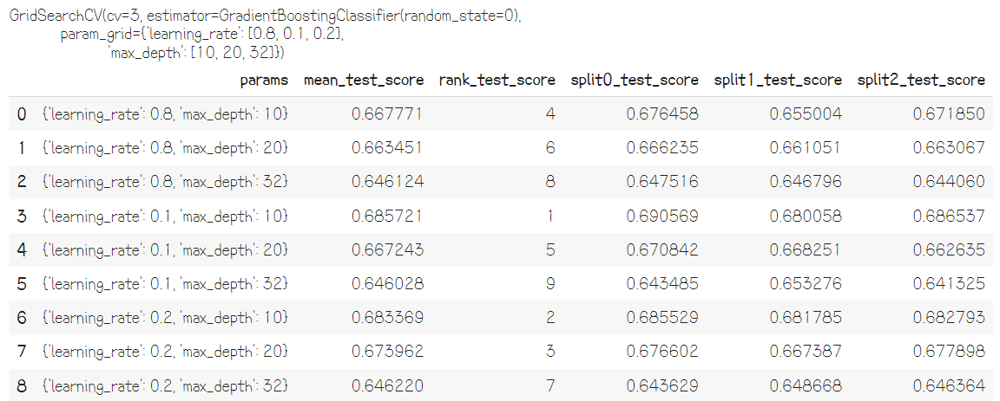

In [ ]:
print('GridSearchCV 최적 파라미터:', grid_gbrt.best_params_)
print('GridSearchCV 최고 정확도: {0:.4f}'.format(grid_gbrt.best_score_))

GridSearchCV 최적 파라미터: {'learning_rate': 0.2, 'max_depth': 15}
GridSearchCV 최고 정확도: 0.7049


In [ ]:
# 최적 파라미터로 학습이 된 모델을 이용하여 시험용 데이터 세트 분류
print("시험용 데이터 세트 정확도: {:.3f}".format(grid_gbrt.score(X_test, y_test)))

시험용 데이터 세트 정확도: 0.549


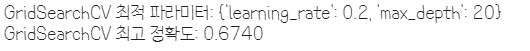

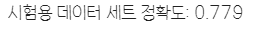

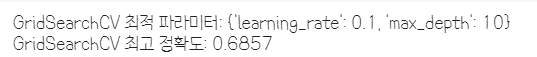

image.png

##### 정오 분류표 : 0.75

In [ ]:
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
import matplotlib.pyplot as plt

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

In [ ]:
print(y_test.value_counts()) # y_test 의 B,M 분포

3.0    3994
4.0    3090
2.0    1351
5.0     341
1.0     154
Name: TENDENCY, dtype: int64


In [ ]:
dt_pred = tree.predict(X_test)
print('Decision tree 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, dt_pred)))
print(confusion_matrix(y_test, dt_pred))

Decision tree 시험용 데이터 세트 정확도:0.750
[[  97    4   31   18    4]
 [  13  920  218  181   19]
 [  22  273 3139  512   48]
 [  27  187  492 2334   50]
 [   4   24   49   56  208]]


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


Text(0.5, 1.0, 'Confusion Matrix')

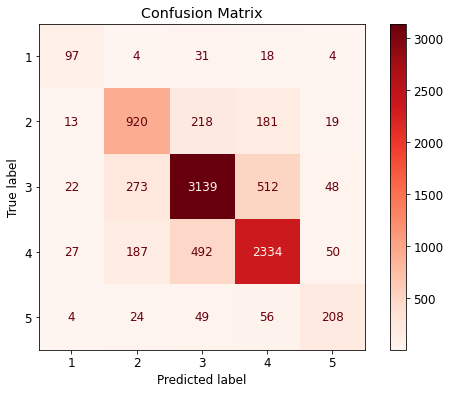

In [ ]:
from sklearn.model_selection import train_test_split
label=['1', '2', '3', '4', '5'] # 라벨 설정
plot = plot_confusion_matrix(tree, X_test, y_test, display_labels=label, cmap=plt.cm.Reds, normalize=None)
plot.ax_.set_title('Confusion Matrix')

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


Text(0.5, 1.0, 'Confusion Matrix')

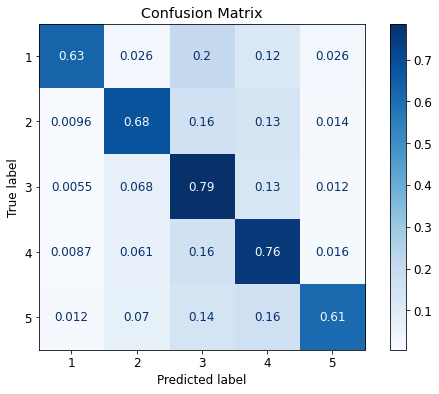

In [ ]:
label=['1', '2', '3', '4', '5']
plot = plot_confusion_matrix(tree, X_test, y_test, display_labels=label, cmap=plt.cm.Blues, normalize='true')  # 정규화
plot.ax_.set_title('Confusion Matrix')

In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("M"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Decision Tree:")
print(classification_report(y_test, dt_pred, target_names=["1", "2", "3", "4", "5"]))

Decision Tree:
              precision    recall  f1-score   support

           1       0.60      0.63      0.61       154
           2       0.65      0.68      0.67      1351
           3       0.80      0.79      0.79      3994
           4       0.75      0.76      0.75      3090
           5       0.63      0.61      0.62       341

    accuracy                           0.75      8930
   macro avg       0.69      0.69      0.69      8930
weighted avg       0.75      0.75      0.75      8930



#### b. WANT 예측

##### 모델링 과정

In [ ]:
df_mww = df_mw.drop(['RESPOND_ID', 'DATE'], axis=1) # 필요없는 변수 삭제

In [ ]:
df_mww = df_mww[['WANT', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK',
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
x = df_mww.iloc[:, 1:]
y = df_mww["WANT"]

# 데이터셋을 학습(train)과 테스트(test) 세트로 분할
# random_state : random 으로 분할시 사용되는 난수 seed 숫자
#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, stratify=y, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state=42)

tree_m = DecisionTreeClassifier(random_state=0)  

tree_m.fit(X_train, y_train) #학습한다는 뜻
print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.762


In [ ]:
# 의사결정나무의 깊이를 5로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_m = DecisionTreeClassifier(max_depth=5, random_state=0)
tree_m.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 0.547
시험용 데이터 정확도: 0.534


In [ ]:
# 의사결정나무의 깊이를 8로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_m = DecisionTreeClassifier(max_depth=8, random_state=0)
tree_m.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 0.594
시험용 데이터 정확도: 0.552


In [ ]:
# 의사결정나무의 깊이를 10로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_m = DecisionTreeClassifier(max_depth=10, random_state=0)
tree_m.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 0.646
시험용 데이터 정확도: 0.567


In [ ]:
# 의사결정나무의 깊이를 34로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_m = DecisionTreeClassifier(max_depth=34, random_state=0)
tree_m.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.762


In [ ]:
# 의사결정나무의 깊이를 40로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_m = DecisionTreeClassifier(max_depth=100, random_state=0)
tree_m.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_m.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_m.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.762


In [ ]:
# filled = True: 색상의 진하기로 클래스를 나타냄, impurity: 불순도 계산값 보여주기 옵션
### export_graphviz(tree(tree 넣어야 함), out_file="tree.dot", class_names=[ (왼쪽)"양성", (오른쪽)"악성"],
###             feature_names=wisc.columns[1:], impurity=False, filled=True)

export_graphviz(tree, out_file="tree.dot", class_names=[ '1.0', '2.0', '3.0', '4.0', '5.0'], feature_names=df_mww.columns[1:], impurity=False, filled=True)

with open("tree.dot") as f:
    dot_graph = f.read()

display(graphviz.Source(dot_graph))

In [ ]:
result = tree_m.feature_importances_
print("변수의 중요도:\n", result)

변수의 중요도:
 [0.01988656 0.04615816 0.09552134 0.04706373 0.04135202 0.07205507
 0.09757137 0.07280666 0.06547287 0.05307527 0.06685678 0.02407057
 0.0304635  0.0399082  0.0398604  0.03494652 0.04589126 0.02894371
 0.03850624 0.03958977]


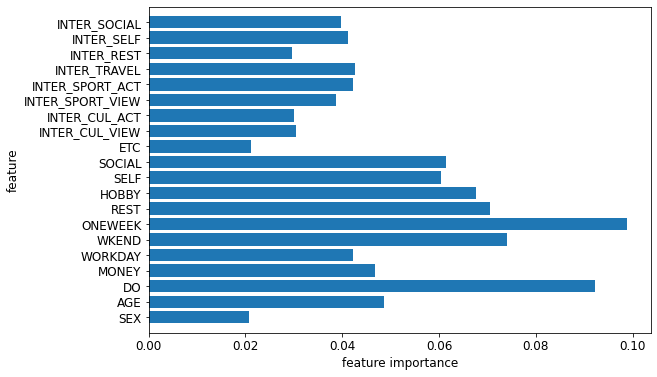

In [ ]:
import numpy as np

def plot_feature_importances_wisc(model):
    plt.rcParams["figure.figsize"] = (9,6)
    n_features = len(df_mww.columns[1:])  # ;WANT' 변수를 제외한 나머지
    plt.barh(np.arange(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), df_mww.columns[1:])   #눈금을 표시하고 눈금 레이블을 변수 이름으로 지정
    plt.xlabel("feature importance")
    plt.ylabel("feature")
    plt.ylim(-1, n_features) #Y 축 범위 지정 (-1 ~ 30)

plot_feature_importances_wisc(tree)

In [ ]:
res = pd.DataFrame(result)
res["name"] = df_mww.columns[1:]
display(res.info())

# perimeter_worst의 비중이 가장 큼, 루트 노드에서 이 값부터 사용 
display(res.sort_values(by='name'))  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       20 non-null     float64
 1   name    20 non-null     object 
dtypes: float64(1), object(1)
memory usage: 448.0+ bytes


None

,0,name
1,0.046158,AGE
2,0.095521,DO
11,0.024071,ETC
8,0.065473,HOBBY
13,0.039908,INTER_CUL_ACT
12,0.030464,INTER_CUL_VIEW
17,0.028944,INTER_REST
18,0.038506,INTER_SELF
19,0.039590,INTER_SOCIAL
15,0.034947,INTER_SPORT_ACT


##### 교차 검증 : 0.724

In [ ]:
# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5
dt_scores = cross_val_score(tree_m, X_train, y_train, cv=10, scoring='accuracy')  

In [ ]:
print("Decision tree: ", dt_scores)
print("Decision tree :{:.3f}".format(dt_scores.mean()))  # 평균

Decision tree:  [0.7096929  0.72888676 0.73416507 0.71545106 0.72504798 0.73163706
 0.72587614 0.71147384 0.73595775 0.72299568]
Decision tree :0.724


In [ ]:
from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
print(kf)

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)


In [ ]:
dt_scores = cross_val_score(tree, X_train, y_train, cv=kf, scoring='accuracy')
print("Accuracy mean -- StratifiedKFold 이용")
print("Decision tree :{:.3f}".format(dt_scores.mean())) 

Accuracy mean -- StratifiedKFold 이용
Decision tree :0.724


##### 그리드 서치 : 0.792

In [ ]:
parameters = {'max_depth':[10, 15,  20, 25, 30, 32], 'learning_rate':[0.3, 0.2, 0.1]}

In [ ]:
init_gbrt = GradientBoostingClassifier(random_state=0)
grid_gbrt = GridSearchCV(init_gbrt, param_grid=parameters, cv=3, refit=True)
print(grid_gbrt)
# 파라미터들을 순차적으로 학습, 검증
grid_gbrt.fit(X_train, y_train)

# GridSearchCV 결과 추출하여 DataFrame으로 변환
scores_df = pd.DataFrame(grid_gbrt.cv_results_)
scores_df[['params', 'mean_test_score', 'rank_test_score', 'split0_test_score', 'split1_test_score', 'split2_test_score']]

GridSearchCV(cv=3, estimator=GradientBoostingClassifier(random_state=0),
             param_grid={'learning_rate': [0.3, 0.2, 0.1],
                         'max_depth': [10, 15, 20, 25, 30, 32]})


,params,mean_test_score,rank_test_score,split0_test_score,split1_test_score,split2_test_score
0,"{'learning_rate': 0.3, 'max_depth': 10}",0.699016,6,0.705400,0.696040,0.695608
1,"{'learning_rate': 0.3, 'max_depth': 15}",0.703048,3,0.706695,0.700360,0.702088
2,"{'learning_rate': 0.3, 'max_depth': 20}",0.688169,8,0.688121,0.693737,0.682649
3,"{'learning_rate': 0.3, 'max_depth': 25}",0.670650,11,0.673866,0.668826,0.669258
4,"{'learning_rate': 0.3, 'max_depth': 30}",0.663067,15,0.670122,0.660043,0.659035
5,"{'learning_rate': 0.3, 'max_depth': 32}",0.663163,14,0.668251,0.661483,0.659755
6,"{'learning_rate': 0.2, 'max_depth': 10}",0.699544,5,0.705976,0.696616,0.696040
7,"{'learning_rate': 0.2, 'max_depth': 15}",0.704872,1,0.708279,0.704536,0.701800
8,"{'learning_rate': 0.2, 'max_depth': 20}",0.694840,7,0.700360,0.696760,0.687401
9,"{'learning_rate': 0.2, 'max_depth': 25}",0.670890,10,0.679194,0.662491,0.670986


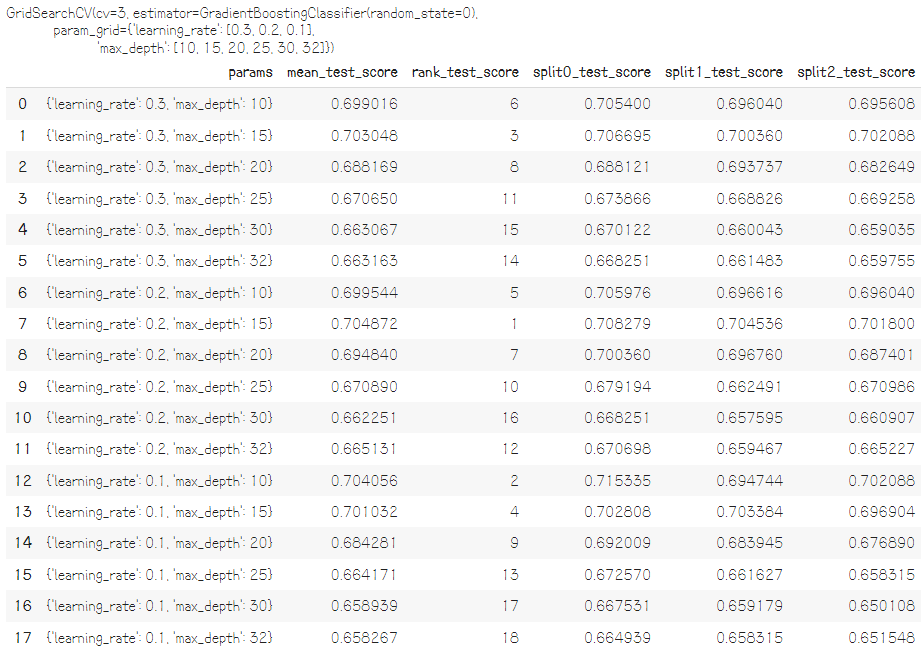

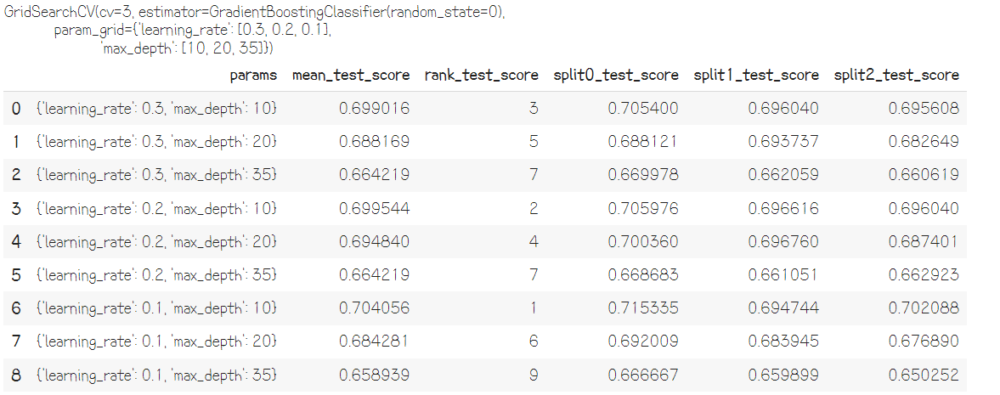

In [ ]:
print('GridSearchCV 최적 파라미터:', grid_gbrt.best_params_)
print('GridSearchCV 최고 정확도: {0:.4f}'.format(grid_gbrt.best_score_))
# 최적 파라미터로 학습이 된 모델을 이용하여 시험용 데이터 세트 분류
print("시험용 데이터 세트 정확도: {:.3f}".format(grid_gbrt.score(X_test, y_test)))

GridSearchCV 최적 파라미터: {'learning_rate': 0.2, 'max_depth': 15}
GridSearchCV 최고 정확도: 0.7049
시험용 데이터 세트 정확도: 0.792


##### 정오 분류표 : 

In [ ]:
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

In [ ]:
print(y_test.value_counts()) # y_test 의 B,M 분포

3.0    3972
4.0    3770
2.0     801
5.0     308
1.0      79
Name: WANT, dtype: int64


In [ ]:
dt_pred = tree.predict(X_test)
print('Decision tree 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, dt_pred)))
print(confusion_matrix(y_test, dt_pred))

Decision tree 시험용 데이터 세트 정확도:0.519
[[  28   16   12   12   11]
 [  30  305  279  166   21]
 [  39  586 2339  909   99]
 [  57  476 1237 1884  116]
 [   9   25   62  130   82]]


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


Text(0.5, 1.0, 'Confusion Matrix')

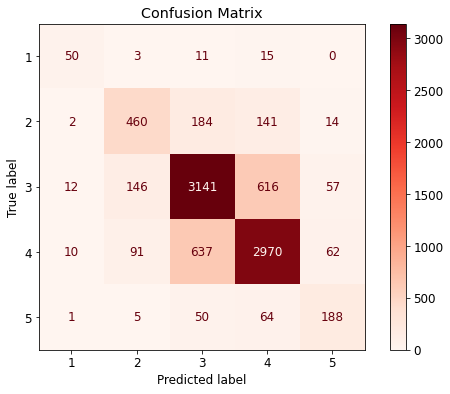

In [ ]:
label=['1', '2', '3', '4', '5'] # 라벨 설정
plot = plot_confusion_matrix(tree_m, X_test, y_test, display_labels=label, cmap=plt.cm.Reds, normalize=None)
plot.ax_.set_title('Confusion Matrix')

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


Text(0.5, 1.0, 'Confusion Matrix')

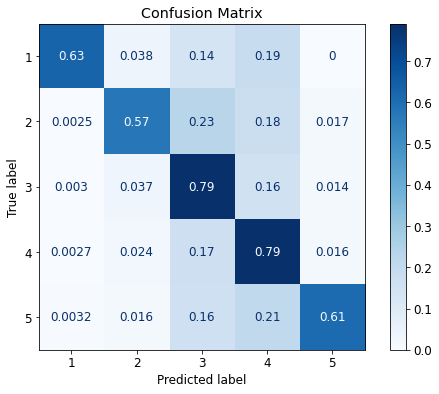

In [ ]:
label=['1', '2', '3', '4', '5']
plot = plot_confusion_matrix(tree_m, X_test, y_test, display_labels=label, cmap=plt.cm.Blues, normalize='true')  # 정규화
plot.ax_.set_title('Confusion Matrix')

In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("M"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Decision Tree:")
print(classification_report(y_test, dt_pred, target_names=["1", "2", "3", "4", "5"]))

Decision Tree:
              precision    recall  f1-score   support

           1       0.17      0.35      0.23        79
           2       0.22      0.38      0.28       801
           3       0.60      0.59      0.59      3972
           4       0.61      0.50      0.55      3770
           5       0.25      0.27      0.26       308

    accuracy                           0.52      8930
   macro avg       0.37      0.42      0.38      8930
weighted avg       0.55      0.52      0.53      8930



### (3) 앙상블 모델

#### a. TENDENCY 예측

###### 랜덤 포레스트

In [ ]:
df_mtt = df_mt.drop(['RESPOND_ID', 'DATE'], axis=1) # 필요없는 변수 삭제

In [ ]:
df_mtt = df_mtt[['TENDENCY', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK',
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
X = df_mtt.iloc[:, 1:]
y = df_mtt["TENDENCY"]

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  "X does not have valid feature names, but"


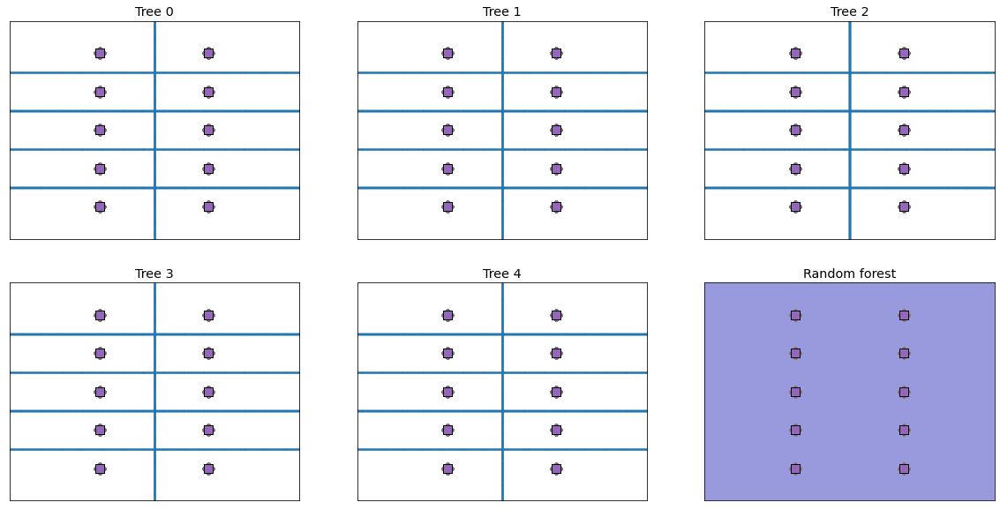

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# radius_mean, texture_mean 변수만 이용하여 
# 5개의 나무를 만드는 예 (n_estimators = 5, 실제는 수백개의 트리를 만든다)
forest = RandomForestClassifier(n_estimators=5, random_state=2)
forest.fit(X_train.iloc[:, 0:2], y_train)

# 5개 나무 각각의 분류 경계를 그림 (서로 모양이 많이 다르다)
# 2차원으로 나무의 결과를 보여주기 위한 코드로 mglearn의 함수들을 이용 - 여기서는 설명 생략
fig, axes = plt.subplots(2, 3, figsize=(20, 10))
for i, (ax, tree) in enumerate(zip(axes.ravel(), forest.estimators_)):
    ax.set_title("Tree {}".format(i))
    mglearn.plots.plot_tree_partition(X.iloc[:, 0:2].values, y, tree, ax=ax)
    
mglearn.plots.plot_2d_separator(forest, X.iloc[:, 0:2].values, fill=True, ax=axes[-1, -1], alpha=.4)
axes[-1, -1].set_title("Random forest")
mglearn.discrete_scatter(X.iloc[:, 0], X.iloc[:, 1], y)
plt.show()

In [ ]:
# 30개 변수를 모두 이용하여 100개의 나무 생성 (정확도가 높아짐)

forest = RandomForestClassifier(n_estimators=100, random_state=0)
forest.fit(X_train, y_train)

print("학습용 데이터 세트 정확도: {:.3f}".format(forest.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(forest.score(X_test, y_test)))

학습용 데이터 세트 정확도: 1.000
시험용 데이터 세트 정확도: 0.801


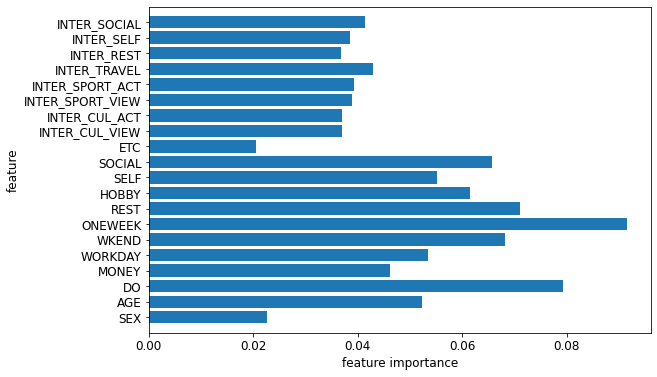

In [ ]:
# 단일 의사결정나무의 경우보다 많은 변수(feature)들이 사용됨
plot_feature_importances_wisc(forest)

In [ ]:
from sklearn.model_selection import cross_val_score

# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5

dt_scores = cross_val_score(tree, X_train, y_train, cv=10, scoring='accuracy')  
rf_scores = cross_val_score(forest, X_train, y_train, cv=10, scoring='accuracy')

print("Accuracy")
print("Decision tree: ", dt_scores) 
print("Random forest: ", rf_scores) 

print("Accuracy mean")
print("Decision tree :{:.3f}".format(dt_scores.mean())) 
print("Random forest :{:.3f}".format(rf_scores.mean())) 

Accuracy
Decision tree:  [0.71641075 0.72840691 0.72168906 0.71833013 0.72072937 0.72107537
 0.72779645 0.71387422 0.70907345 0.72299568]
Random forest:  [0.77879079 0.78502879 0.7768714  0.77543186 0.78886756 0.78540566
 0.77196351 0.75708113 0.76524244 0.76908305]
Accuracy mean
Decision tree :0.720
Random forest :0.775


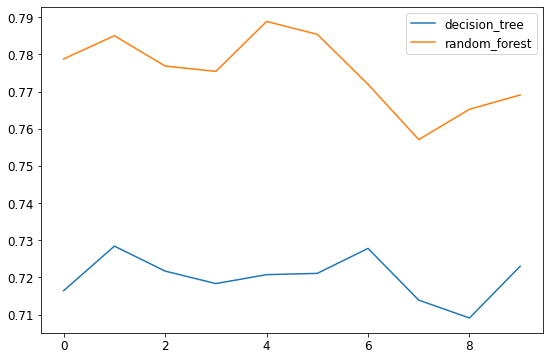

In [ ]:
cv_list = [    
            ['decision_tree',dt_scores],
            ['random_forest',rf_scores],
          ]
df = pd.DataFrame.from_dict(dict(cv_list))
df.plot()

###### 그래디언트 부스팅

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
# 기본값은 max_depth= 3, n_estimators=100, learning_rate = 0.1

gbrt = GradientBoostingClassifier(random_state=0)
gbrt.fit(X_train, y_train)

GradientBoostingClassifier(random_state=0)

In [ ]:
print("학습용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습용 데이터 세트 정확도: 0.593
시험용 데이터 세트 정확도: 0.569


In [ ]:
#나무 깊이 제한
gbrt = GradientBoostingClassifier(random_state=0, max_depth=10)
gbrt.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.999
시험용 데이터 세트 정확도: 0.794


In [ ]:
#학습률 감소
gbrt = GradientBoostingClassifier(random_state=0, learning_rate=0.01)
gbrt.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.553
시험용 데이터 세트 정확도: 0.548


##### 교차검증 (0.775, 0.546)

In [ ]:
rf_scores = cross_val_score(forest, X_train, y_train, cv=10, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt, X_train, y_train, cv=10, scoring='accuracy')
print("Random forest: ", rf_scores) 
print("Gradient boosting: ", gbrt_scores) 
print("Random forest :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

Random forest:  [0.77879079 0.78502879 0.7768714  0.77543186 0.78886756 0.78540566
 0.77196351 0.75708113 0.76524244 0.76908305]
Gradient boosting:  [0.54942418 0.55134357 0.55566219 0.54702495 0.55758157 0.54392703
 0.53336534 0.52808449 0.54296687 0.55256841]
Random forest :0.775
Gradient boosting :0.546


In [ ]:
# 교차 검증 상세 옵션 지정

# KFold :기본값 n_splits=5, shuffle=None (데이터를 임의로 섞지 않음) 
# LeaveOneOut :데이터 1개를 검증에 이용 
# ShuffleSplit :임의 분할, 전체 데이터를 모두 사용하지 않을 수도 있음
# GroupKFold :그룹을 지정해서 같은 그룹의 데이터는 학습용 또는 검증용으로 동일하게 분할
# StratifiedKFold :각 fold마다 클래스의 분포가 동일하도록 분할 (예. 악성:양성) 
# RepeatedStratifiedKFold: 교차검증을 반복, 기본값 n_repeats =10

from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
#from sklearn.model_selection import RepeatedStratifiedKFold
#kf = RepeatedStratifiedKFold(n_splits=10)

print(kf)
rf_scores = cross_val_score(forest, X_train, y_train, cv=kf, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt, X_train, y_train, cv=kf, scoring='accuracy')
print("Accuracy mean -- StratifiedKFold 이용")
print("Random forest :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)
Accuracy mean -- StratifiedKFold 이용
Random forest :0.775
Gradient boosting :0.546


##### 정오 분류표 : 

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

print(y_test.value_counts()) # y_test 의 B,M 분포

rf_pred = forest.predict(X_test)
grid_gbrt_pred = grid_gbrt.predict(X_test)

# 예측 결과인 pred와 실제 결과인 y_test의 Confusion Matrix 출력
print('Random forest 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, rf_pred)))
print(confusion_matrix(y_test, rf_pred))
print('Gradient boosting 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, grid_gbrt_pred)))
print(confusion_matrix(y_test, grid_gbrt_pred))

3.0    3972
4.0    3770
2.0     801
5.0     308
1.0      79
Name: WANT, dtype: int64
Random forest 시험용 데이터 세트 정확도:0.801
[[  49    2   22    6    0]
 [   1  436  226  138    0]
 [   0    4 3358  608    2]
 [   0    4  633 3129    4]
 [   0    0   42   88  178]]
Gradient boosting 시험용 데이터 세트 정확도:0.792
[[  52    3   13    9    2]
 [   4  440  235  122    0]
 [  18   23 3329  599    3]
 [   8   21  653 3075   13]
 [   4    2   51   71  180]]


In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("M"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Random Forest:")
print(classification_report(y_test, rf_pred, target_names=["1", "2", "3", "4", "5"]))
print("Gradient Boosting:")
print(classification_report(y_test, grid_gbrt_pred, target_names=["1", "2", "3", "4", "5"]))

Random Forest:
              precision    recall  f1-score   support

           1       0.98      0.62      0.76        79
           2       0.98      0.54      0.70       801
           3       0.78      0.85      0.81      3972
           4       0.79      0.83      0.81      3770
           5       0.97      0.58      0.72       308

    accuracy                           0.80      8930
   macro avg       0.90      0.68      0.76      8930
weighted avg       0.81      0.80      0.80      8930

Gradient Boosting:
              precision    recall  f1-score   support

           1       0.60      0.66      0.63        79
           2       0.90      0.55      0.68       801
           3       0.78      0.84      0.81      3972
           4       0.79      0.82      0.80      3770
           5       0.91      0.58      0.71       308

    accuracy                           0.79      8930
   macro avg       0.80      0.69      0.73      8930
weighted avg       0.80      0.79      0.79

#### b. WANT 예측

In [ ]:
df_mww = df_mw.drop(['RESPOND_ID', 'DATE'], axis=1) # 필요없는 변수 삭제
df_mww = df_mww[['WANT', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK',
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
X = df_mww.iloc[:, 1:]
y = df_mww["WANT"]

##### 랜덤 포레스트

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  "X does not have valid feature names, but"


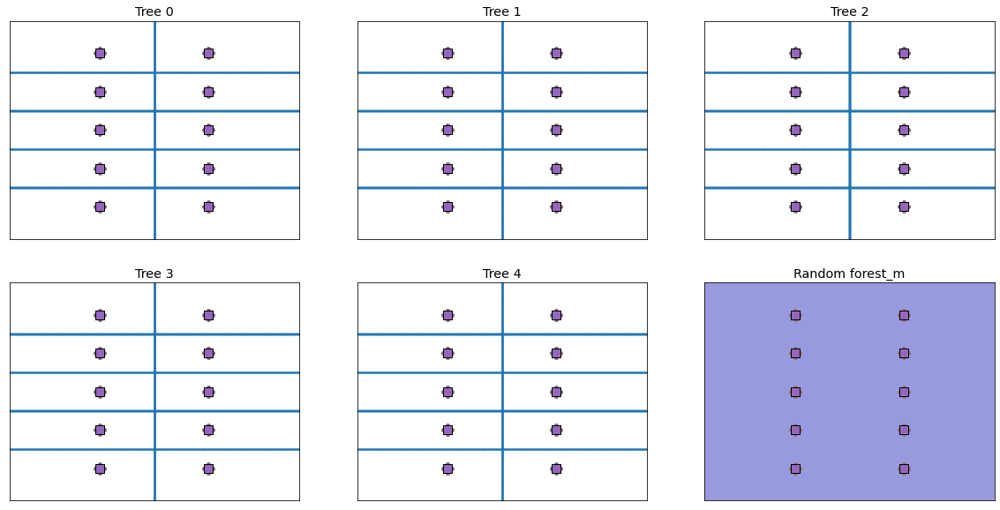

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# radius_mean, texture_mean 변수만 이용하여 
# 5개의 나무를 만드는 예 (n_estimators = 5, 실제는 수백개의 트리를 만든다)
forest_m = RandomForestClassifier(n_estimators=5, random_state=2)
forest_m.fit(X_train.iloc[:, 0:2], y_train)

# 5개 나무 각각의 분류 경계를 그림 (서로 모양이 많이 다르다)
# 2차원으로 나무의 결과를 보여주기 위한 코드로 mglearn의 함수들을 이용 - 여기서는 설명 생략
fig, axes = plt.subplots(2, 3, figsize=(20, 10))
for i, (ax, tree) in enumerate(zip(axes.ravel(), forest_m.estimators_)):
    ax.set_title("Tree {}".format(i))
    mglearn.plots.plot_tree_partition(X.iloc[:, 0:2].values, y, tree, ax=ax)
    
mglearn.plots.plot_2d_separator(forest_m, X.iloc[:, 0:2].values, fill=True, ax=axes[-1, -1], alpha=.4)
axes[-1, -1].set_title("Random forest_m")
mglearn.discrete_scatter(X.iloc[:, 0], X.iloc[:, 1], y)
plt.show()

In [ ]:
# 30개 변수를 모두 이용하여 100개의 나무 생성 (정확도가 높아짐)

forest_m = RandomForestClassifier(n_estimators=100, random_state=0)
forest_m.fit(X_train, y_train)

print("학습용 데이터 세트 정확도: {:.3f}".format(forest_m.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(forest_m.score(X_test, y_test)))

학습용 데이터 세트 정확도: 1.000
시험용 데이터 세트 정확도: 0.801


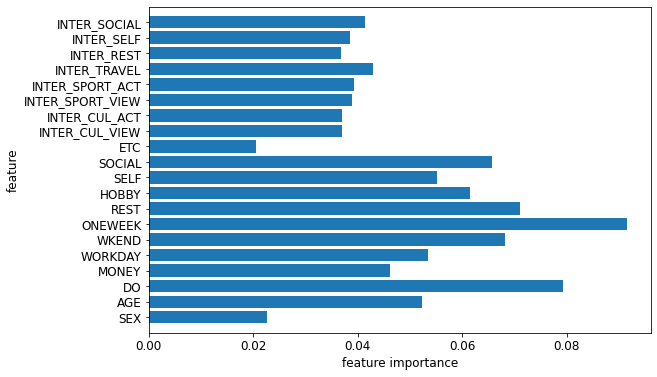

In [ ]:
# 단일 의사결정나무의 경우보다 많은 변수(feature)들이 사용됨
plot_feature_importances_wisc(forest_m)

In [ ]:
from sklearn.model_selection import cross_val_score

# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5

dt_scores = cross_val_score(tree_m, X_train, y_train, cv=10, scoring='accuracy')  
rf_scores = cross_val_score(forest_m, X_train, y_train, cv=10, scoring='accuracy')

print("Accuracy")
print("Decision tree_m: ", dt_scores) 
print("Random forest_m: ", rf_scores) 

print("Accuracy mean")
print("Decision tree_m :{:.3f}".format(dt_scores.mean())) 
print("Random forest_m :{:.3f}".format(rf_scores.mean())) 

Accuracy
Decision tree_m:  [0.7096929  0.72888676 0.73416507 0.71545106 0.72504798 0.73163706
 0.72587614 0.71147384 0.73595775 0.72299568]
Random forest_m:  [0.77879079 0.78502879 0.7768714  0.77543186 0.78886756 0.78540566
 0.77196351 0.75708113 0.76524244 0.76908305]
Accuracy mean
Decision tree_m :0.724
Random forest_m :0.775


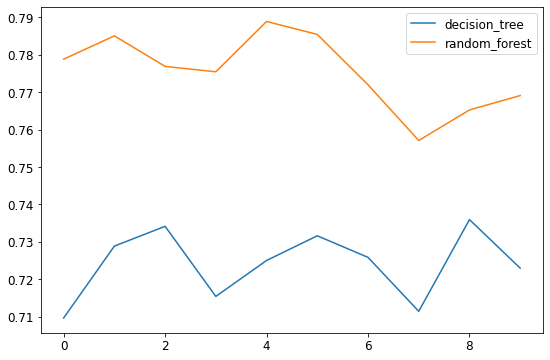

In [ ]:
cv_list = [    
            ['decision_tree',dt_scores],
            ['random_forest',rf_scores],
          ]
df = pd.DataFrame.from_dict(dict(cv_list))
df.plot()

##### 그래디언트 부스팅

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
# 기본값은 max_depth= 3, n_estimators=100, learning_rate = 0.1

gbrt_m = GradientBoostingClassifier(random_state=0)
gbrt_m.fit(X_train, y_train)

GradientBoostingClassifier(random_state=0)

In [ ]:
print("학습용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습용 데이터 세트 정확도: 0.553
시험용 데이터 세트 정확도: 0.548


In [ ]:
#나무 깊이 제한
gbrt_m = GradientBoostingClassifier(random_state=0, max_depth=15)
gbrt_m.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_test, y_test)))

학습 데이터 세트 정확도: 1.000
시험용 데이터 세트 정확도: 0.795


In [ ]:
#학습률 증가
gbrt_m = GradientBoostingClassifier(random_state=0, learning_rate=0.2)
gbrt_m.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.615
시험용 데이터 세트 정확도: 0.574


In [ ]:
#학습률 감소
gbrt_m = GradientBoostingClassifier(random_state=0, learning_rate=0.1)
gbrt_m.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_m.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.593
시험용 데이터 세트 정확도: 0.569


##### 교차검증 (0.775, 0.769)

In [ ]:
rf_scores = cross_val_score(forest_m, X_train, y_train, cv=10, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt_m, X_train, y_train, cv=10, scoring='accuracy')
print("Random forest_m: ", rf_scores) 
print("Gradient boosting: ", gbrt_scores) 
print("Random forest_m :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

Random forest_m:  [0.77879079 0.78502879 0.7768714  0.77543186 0.78886756 0.78540566
 0.77196351 0.75708113 0.76524244 0.76908305]
Gradient boosting:  [0.76391555 0.78214971 0.77207294 0.7634357  0.77735125 0.78540566
 0.76284205 0.7537206  0.76332213 0.76572252]
Random forest_m :0.775
Gradient boosting :0.769


In [ ]:
# 교차 검증 상세 옵션 지정

# KFold :기본값 n_splits=5, shuffle=None (데이터를 임의로 섞지 않음) 
# LeaveOneOut :데이터 1개를 검증에 이용 
# ShuffleSplit :임의 분할, 전체 데이터를 모두 사용하지 않을 수도 있음
# GroupKFold :그룹을 지정해서 같은 그룹의 데이터는 학습용 또는 검증용으로 동일하게 분할
# StratifiedKFold :각 fold마다 클래스의 분포가 동일하도록 분할 (예. 악성:양성) 
# RepeatedStratifiedKFold: 교차검증을 반복, 기본값 n_repeats =10

from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
#from sklearn.model_selection import RepeatedStratifiedKFold
#kf = RepeatedStratifiedKFold(n_splits=10)

print(kf)
rf_scores = cross_val_score(forest_m, X_train, y_train, cv=kf, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt_m, X_train, y_train, cv=kf, scoring='accuracy')
print("Accuracy mean -- StratifiedKFold 이용")
print("Random forest_m :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)
Accuracy mean -- StratifiedKFold 이용
Random forest_m :0.775
Gradient boosting :0.769


##### 정오 분류표 : 

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

print(y_test.value_counts()) # y_test 의 B,M 분포

rf_pred = forest.predict(X_test)
grid_gbrt_pred = grid_gbrt.predict(X_test)

# 예측 결과인 pred와 실제 결과인 y_test의 Confusion Matrix 출력
print('Random forest 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, rf_pred)))
print(confusion_matrix(y_test, rf_pred))
print('Gradient boosting 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, grid_gbrt_pred)))
print(confusion_matrix(y_test, grid_gbrt_pred))

3.0    3972
4.0    3770
2.0     801
5.0     308
1.0      79
Name: WANT, dtype: int64
Random forest 시험용 데이터 세트 정확도:0.801
[[  49    2   22    6    0]
 [   1  436  226  138    0]
 [   0    4 3358  608    2]
 [   0    4  633 3129    4]
 [   0    0   42   88  178]]
Gradient boosting 시험용 데이터 세트 정확도:0.792
[[  52    3   13    9    2]
 [   4  440  235  122    0]
 [  18   23 3329  599    3]
 [   8   21  653 3075   13]
 [   4    2   51   71  180]]


In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("M"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Random Forest:")
print(classification_report(y_test, rf_pred, target_names=["1", "2", "3", "4", "5"]))
print("Gradient Boosting:")
print(classification_report(y_test, grid_gbrt_pred, target_names=["1", "2", "3", "4", "5"]))

Random Forest:
              precision    recall  f1-score   support

           1       0.98      0.62      0.76        79
           2       0.98      0.54      0.70       801
           3       0.78      0.85      0.81      3972
           4       0.79      0.83      0.81      3770
           5       0.97      0.58      0.72       308

    accuracy                           0.80      8930
   macro avg       0.90      0.68      0.76      8930
weighted avg       0.81      0.80      0.80      8930

Gradient Boosting:
              precision    recall  f1-score   support

           1       0.60      0.66      0.63        79
           2       0.90      0.55      0.68       801
           3       0.78      0.84      0.81      3972
           4       0.79      0.82      0.80      3770
           5       0.91      0.58      0.71       308

    accuracy                           0.79      8930
   macro avg       0.80      0.69      0.73      8930
weighted avg       0.80      0.79      0.79